# **Project 3**, APS1070 Summer 2024
#### **PCA [14 marks]**
**Deadline: Jun 30th, 23:00**

**Academic Integrity**

This project is individual - it is to be completed on your own. If you have questions, please post your query in the APS1070 Piazza Q&A forums (the answer might be useful to others!).

Do not share your code with others, or post your work online. Do not submit code that you have not written yourself. Students suspected of plagiarism on a project, midterm or exam will be referred to the department for formal discipline for breaches of the Student Code of Conduct.

In this project we work on [flight delays dataset](https://www.kaggle.com/datasets/gabrielluizone/us-domestic-flights-delay-prediction-2013-2018) that reports scheduled and actual departure and arrival times reported by certified US air carriers. This dataset contains date, origin, destination, airline, distance, and delay status of flights for flights between 2016 and 2018.

Please fill out the following:


*   Bader Al-Hilawani:
*   1009724498:



### How to submit **(HTML + IPYNB)**

1. Download your notebook: `File -> Download .ipynb`

2. Click on the Files icon on the far left menu of Colab

3. Select & upload your `.ipynb` file you just downloaded, and then obtain its path (right click) (you might need to hit the Refresh button before your file shows up)


4. execute the following in a Colab cell:
```
%%shell
jupyter nbconvert --to html /PATH/TO/YOUR/NOTEBOOKFILE.ipynb
```

5. An HTML version of your notebook will appear in the files, so you can download it.

6. Submit **both** <font color='red'>`HTML` and `IPYNB`</font>  files on Quercus for grading.



Ref: https://stackoverflow.com/a/64487858



In [238]:
%%shell
jupyter nbconvert --to html /content/S24_APS1070_Project_3 (3).ipynb

/bin/bash: -c: line 1: syntax error near unexpected token `('
/bin/bash: -c: line 1: `jupyter nbconvert --to html /content/S24_APS1070_Project_3 (3).ipynb'


CalledProcessError: Command 'jupyter nbconvert --to html /content/S24_APS1070_Project_3 (3).ipynb
' returned non-zero exit status 2.

# Part 1: Getting started with GitHub [1.5 Marks + 1.5 Mark Git Submission]

This first part of the project assignment is to be completed independently from Parts 2 - 5. In this part you will be completing some coding tasks and submitting your results on Github. To access this part of the assignment and upload your answers, you will need to use Github. Please complete the following step-by-step instructions:

 0. Create a Github account and install git for Windows or Mac:
  * https://git-scm.com/download/win
  * https://git-scm.com/download/mac

 1. Create a personal access token using your Github account. Go to Settings >> Developer Settings >> Personal access tokens >> Tokens (classic) and generate a new token (also classic). When creating the token make sure to fill the `Note` section and select the repo scope (for repository access, like pushing) and workflow (required to modify workflow files). Make sure you copy the Personal Access Token as soon as it gets generated.


 2. Open this link: https://classroom.github.com/a/-r7kBDwM to create your assignment repository in GitHub. You should get a link similar to:
```
https://github.com/APS1070-UofT/s24-project-3-part-1-*********
```
This your private repository to get this part questions and upload your answers. **Copy this link to the text box below to be graded for this part.**

In [211]:
### Add the link here ###
#https://github.com/APS1070-UofT/s24-project-3-part-1-balhilawani

 3. Open `Git Bash`, the app you downloaded in step `0`, and set your Email and username by:
```
git config --global user.email “<your-GitHub-email>”
git config --global user.name “<your-GitHub-username>”
```

 4. Create a folder for the course on your computer and `cd` to that. `cd` means `Change Directory`. For example, on a Windows machine, where I have a folder on "C:\aps1070":
 ```
cd c:aps1070
```
 5. Get your assignment by the link you got in step 2:
```
git clone https://github.com/APS1070-UofT/s24-project-3-part-1-*********
```

 6. You will be asked to enter your Github username and password. Enter the username for your github account into the `Username` field, and paste the `personal access token` which you copied in step 1, into the `Password` field.


 7. A new folder should be created in your directory similar to:
```
C:\aps1070\s24-project-3-part-1-********
```
This folder has an `ipynb` notebook which you need to manually upload to colab and answer its questions.

 8. After you finished working on this notebook, download the notebook from colab and move it to the directory in step 7.

 9. Replace the old notebook with the new one that has your answers. Make sure your completed notebook has the same name as the original notebook you downloaded.

 10. To submit your work, follow:
```
cd <your assignment folder>
git add S24_Project_3_Part_1_git.ipynb
git commit -m "Final Submission"
git push
```
If you have any problem with pushing your work on GitHub you can try one of following commands:
```
git push --force
or
git push origin HEAD:main
```

 11. Make sure your submission is ready for grading. Open the private repository link in your browser and make sure you can see your final submission with your latest changes there. **Only you and the teaching team can open that link.**

In [212]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler

In [213]:
import pandas as pd
data_raw = pd.read_csv(
    filepath_or_buffer='https://raw.githubusercontent.com/Sabaae/Dataset/main/TotalDelaysbyState.csv',
    index_col=0
)




In [214]:
print(data_raw)

           2016-01-01  2016-01-02  2016-01-03  2016-01-04  2016-01-05  \
DestState                                                               
AZ              742.0      2262.0      1095.0      1247.0      1197.0   
CA             2552.0      2849.0      5492.0      8256.0      6821.0   
CO              711.0      1361.0      1172.0      1206.0       670.0   
GA              378.0       393.0       908.0       902.0       805.0   
IL              331.0       517.0      1831.0      1691.0      1102.0   
NC              171.0       448.0       651.0       640.0       846.0   
TX             2747.0      1089.0      2517.0      1114.0      1972.0   

           2016-01-06  2016-01-07  2016-01-08  2016-01-09  2016-01-10  ...  \
DestState                                                              ...   
AZ             1481.0      1400.0      1263.0       859.0       596.0  ...   
CA            12656.0      4238.0      3912.0      1132.0      2024.0  ...   
CO              946.0       96

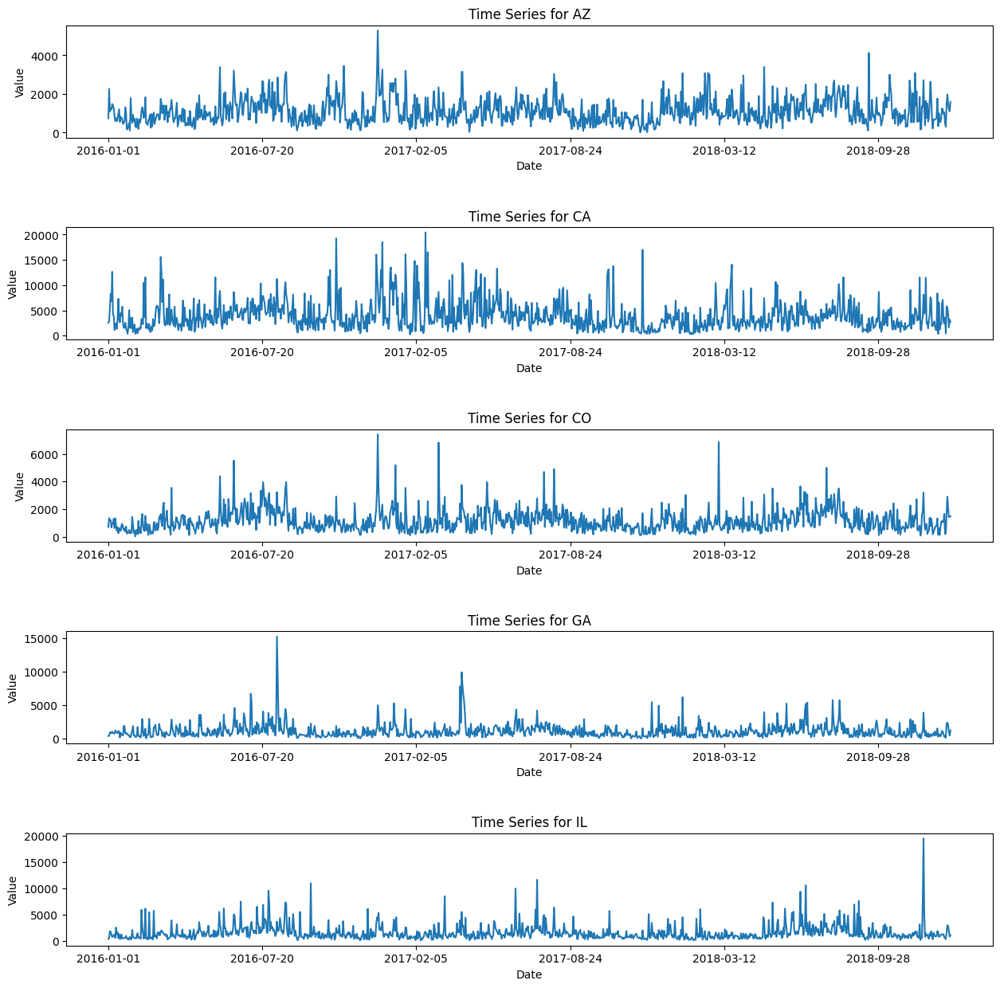

In [215]:
import matplotlib.pyplot as plt
def plot_time_series(data_raw, DestState):

    State_length = len(DestState) #lenght of the deststate in the data_raw
    plt.figure(figsize=(15, 15))
    for i, state in enumerate(DestState): #loops through all the deststate in the data_raw

        plt.subplot(State_length, 1, i + 1)

        data_raw.loc[state].plot()
        plt.title(f'Time Series for {state}')
        plt.ylabel('Value')
        plt.xlabel('Date')

    plt.subplots_adjust(hspace=0.8)
    plt.show()


plot_time_series(data_raw, ['AZ', 'CA', 'CO', 'GA', 'IL'])

2016-01-01    9.516197e-17
2016-01-02   -3.965082e-18
2016-01-03    5.551115e-17
2016-01-04    5.551115e-17
2016-01-05   -8.425800e-18
                  ...     
2018-12-27    6.344132e-17
2018-12-28    0.000000e+00
2018-12-29   -2.854859e-16
2018-12-30   -7.930164e-17
2018-12-31    1.586033e-16
Length: 1095, dtype: float64
-----
2016-01-01    1.080123
2016-01-02    1.080123
2016-01-03    1.080123
2016-01-04    1.080123
2016-01-05    1.080123
                ...   
2018-12-27    1.080123
2018-12-28    1.080123
2018-12-29    1.080123
2018-12-30    1.080123
2018-12-31    1.080123
Length: 1095, dtype: float64
STD data


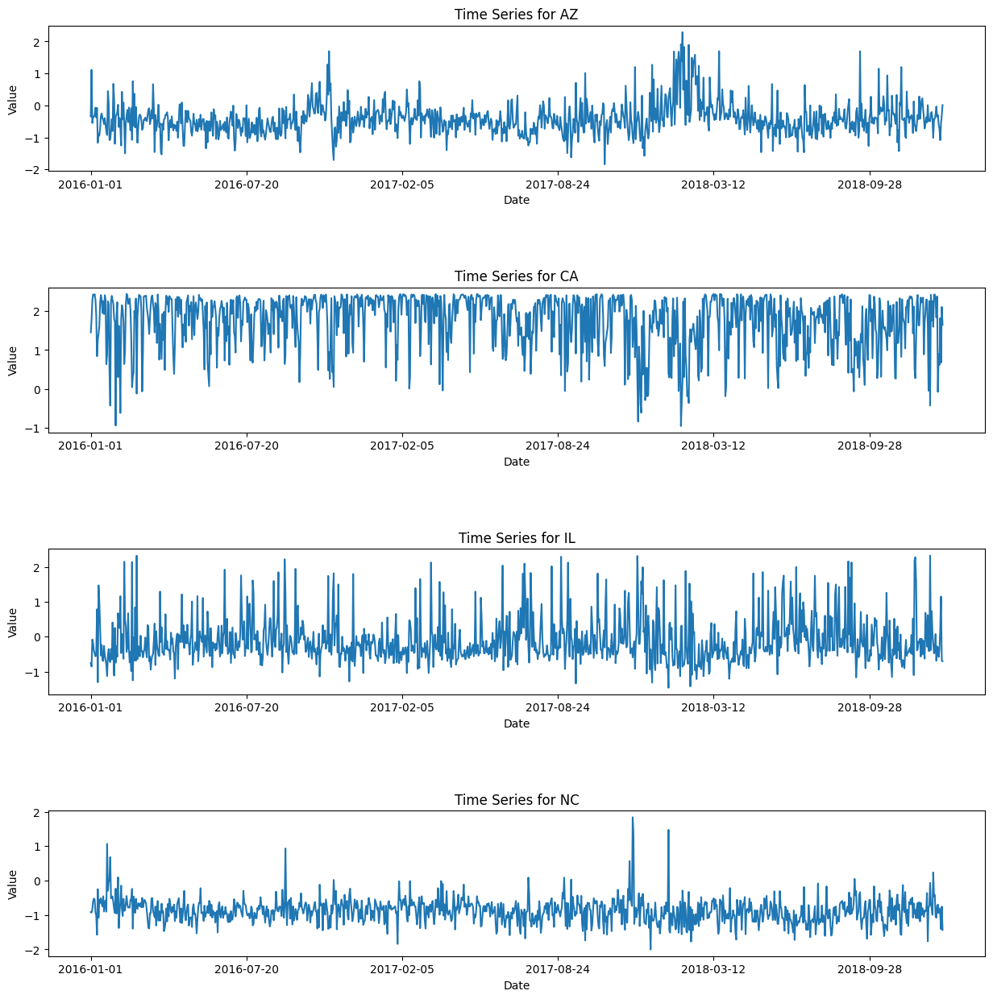



Not STD data


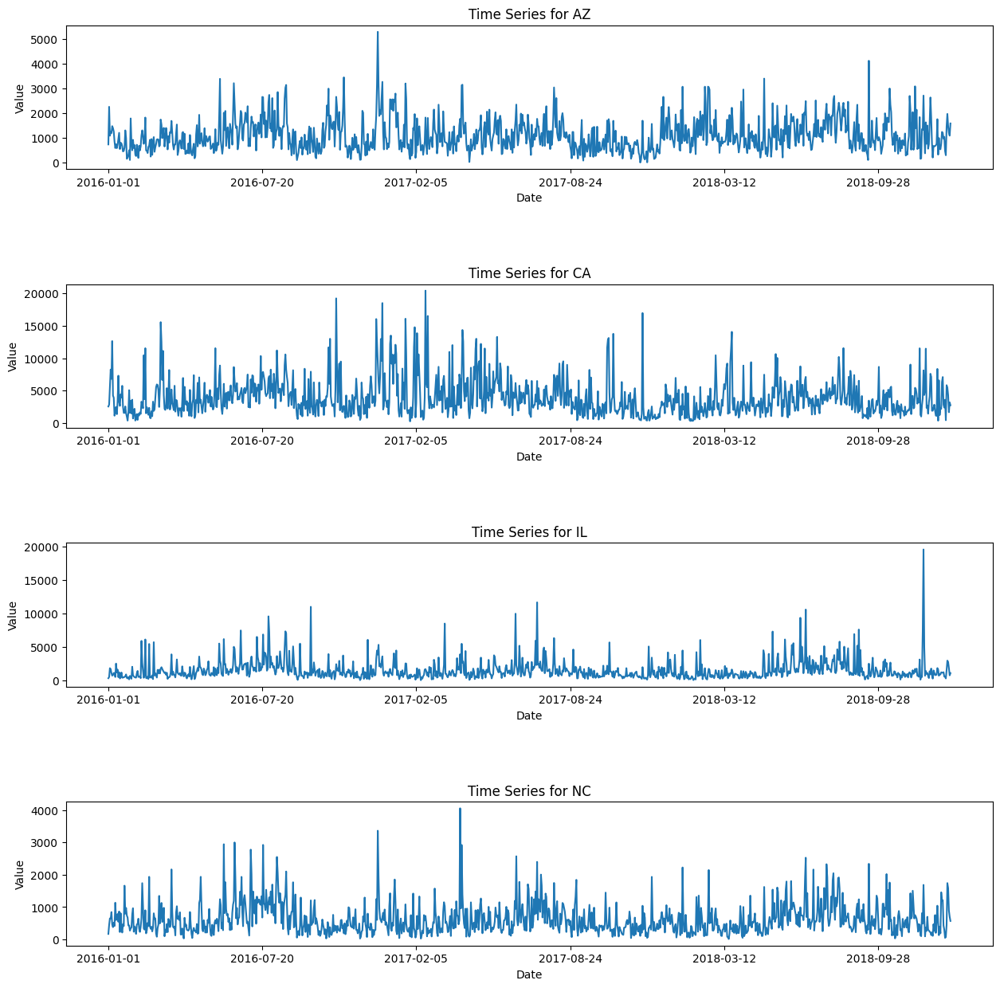

(7, 1095)


In [216]:

from sklearn.preprocessing import StandardScaler

STD_data_raw = StandardScaler().fit_transform(data_raw) #STD the data_raw

STD_data_raw = pd.DataFrame(STD_data_raw, index=data_raw.index, columns=data_raw.columns)#put the data back into a df
print(STD_data_raw.mean())
print("-----")
print(STD_data_raw.std())

print("STD data")
plot_time_series(STD_data_raw, ['AZ', 'CA','IL', 'NC'])
print("\n")
print("Not STD data")
plot_time_series(data_raw, ['AZ', 'CA','IL', 'NC'])

print(STD_data_raw.shape)

Part 1 - 4)
---
Discuss the trends in the standardized time-series for AZ, CA, IL and NC. What does it mean if the curve goes up or down? What does the sign of values indicate? [0.5]
___
Since the data was standardized therefore there is a mean of 0 and standard deviation of 1, the trends in the data changed compared to the data not being standardized. For example, if we look state ['CA'] the not standardized data had multiple peaks spread across the plot. However, when looking at the standardized data the plot for ['CA'] is more uniform and consistent throughout since we made the mean 0 and standard deviation 1. Thus, the deviations can be compared (easily) relative to the mean. Looking at state ['AZ'] the standardized data can be seen slightly increasing then decreasing relative to the mean compared the not standardized data. For state ['IL'] the data seems uniform across with the values constantly increasing and decreasing throughout the dates. Finally, looking at state ['NC'] he standardized data is uniform overall, except for a few peaks, but the values generally stayed consistent over time
___
If the curve goes up that means that the values in the data are increasing relatively to the mean. When the curve goes does it means the opposite, the data values int he data are decreasing relative to the mean.
___
Depending on the sign, a positive sign for the values indicate that the value is above the mean and a negative sign for the values indicate that the value is below the mean.


# Part 2: Applying PCA [2 Marks]

1. Compute the covariance matrix of the dataframe. *Hint: The dimensions of your covariance matrix should be ((1095, 1095).* **[0.25]**
2. Write a function `get_sorted_eigen(df_cov)` that gets the covariance matrix of dataframe `df` (from step 1), and returns sorted eigenvalues and eigenvectors using `np.linalg.eigh`. **[0.25]**
3. Show the effectiveness of your principal components in covering the variance of the dataset with a `scree plot`. *Hint: Limit the scree plot to the first 10 PCs . **[0.25]**
4. How many PCs do you need to cover 90% of the dataset's variance? **[0.25]**
5. Plot the first 16 principal components (Eigenvectors) as a time series (16 subplots, on the x-axis you have dates and on the y-axis you have the value of the PC element) . **[0.5]**
6. Compare the first few PCs with the rest of them. Do you see any difference in their trend? **[0.5]**

In [217]:
n, m = data_raw.shape
#compute covariance matrix
df_cov = np.dot(data_raw.T, data_raw)/(n-1)
# C = np.cov(STD_data_raw.T) or you can use this to compute the covariance
print(df_cov.shape)
print("\n")

def get_sorted_eigen(df_cov):
    eigenValues, eigenVectors = np.linalg.eigh(df_cov)
    idx = np.argsort(-eigenValues)
    eigenValues = eigenValues[idx]
    eigenVectors = eigenVectors[:,idx]

    return eigenValues, eigenVectors

print(get_sorted_eigen(df_cov))




(1095, 1095)


(array([ 6.81674162e+09,  6.38803673e+08,  2.16103857e+08, ...,
       -3.02383244e-06, -3.09577323e-06, -3.61941702e-06]), array([[-0.01772267, -0.00716157, -0.03847029, ...,  0.        ,
         0.        , -0.00441674],
       [-0.01821495,  0.00508788, -0.00778758, ...,  0.00704849,
        -0.01539329,  0.42643204],
       [-0.03250707,  0.00781194, -0.00050174, ..., -0.07350091,
        -0.01879153, -0.26194015],
       ...,
       [-0.0170373 , -0.0255541 ,  0.00828525, ...,  0.00454123,
         0.0224314 ,  0.02283888],
       [-0.02054852,  0.00047885, -0.01394105, ...,  0.01936814,
        -0.07082709,  0.01059038],
       [-0.0216099 , -0.01518263, -0.01680243, ..., -0.02764699,
         0.0202225 ,  0.02326163]]))


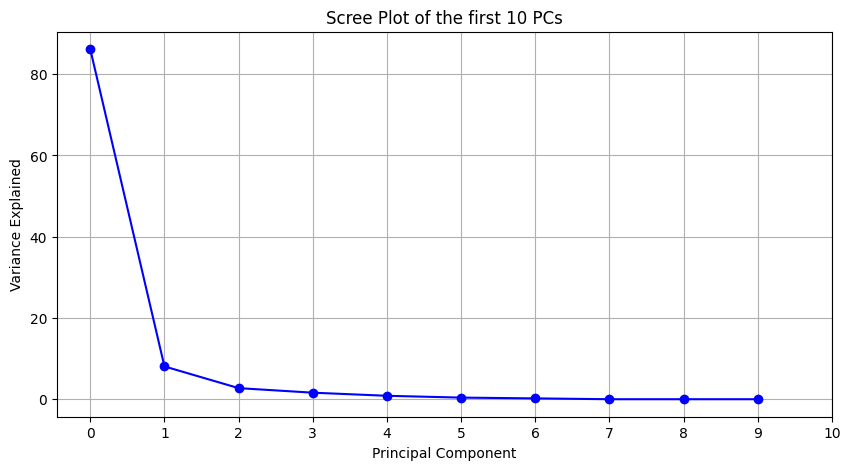

Number of PCs needed to cover 90% of the dataset's variance is: 2
               0
0      86.137714
1      94.209765
2      96.940497
3      98.550281
4      99.396611
...          ...
1090  100.000000
1091  100.000000
1092  100.000000
1093  100.000000
1094  100.000000

[1095 rows x 1 columns]
[86.13771417340246, 8.072051315839053, 2.7307316734829024, 1.609783764173964, 0.846330507974725, 0.39715381538671146, 0.2062347497402454, 5.013745881250602e-14, 3.80186001305484e-14, 3.4250875762229775e-14, 2.9098429315047906e-14, 2.6518733306158897e-14, 2.2722800310725152e-14, 2.0972541932246827e-14, 1.4642763379467285e-14, 1.1891825829643963e-14, 1.1328980012542494e-14, 1.1142321193443288e-14, 1.0725780804689412e-14, 9.725867123987328e-15, 8.917920144599247e-15, 8.157707421039952e-15, 7.736552120301054e-15, 6.813677504986849e-15, 6.4471306983226145e-15, 6.0423494881250616e-15, 5.7779667196308566e-15, 4.9012794083680645e-15, 4.582483028086144e-15, 4.260398002028579e-15, 3.851905046782501e-15, 3.

In [218]:
#scree plot (to vosualize the eigenvalues of the df_cov matrix which helps in determining the number of significant principal components in PCA)
eigenValues, eigenVectors = get_sorted_eigen(df_cov)
eigValSum = sum(eigenValues)
expVar = [eigV/eigValSum*100 for eigV in eigenValues]
cumExpVar = np.cumsum(expVar)

n_components = 10
#First 10 principal components


#first_10_PCs = eigenVectors[:, :n_components]


#Scree plot
plt.figure(figsize=(10, 5))
#x = range(1, n_components + 1)
y = expVar[:n_components]
#plt.plot(x, y, 'o-', color='blue')
plt.plot(y, 'o-', color='blue')

plt.title('Scree Plot of the first 10 PCs')
plt.xlabel('Principal Component')
plt.ylabel('Variance Explained')
plt.xticks(range(0, n_components + 1))
plt.grid(True)
plt.show()

expVar_90 = np.argmax(cumExpVar >= 90) + 1
print(f"Number of PCs needed to cover 90% of the dataset's variance is: {expVar_90}")
cumExpVar_check = pd.DataFrame(cumExpVar)
print(cumExpVar_check.iloc[:,:])
print(expVar)

In [219]:
# eigValSum = sum(eigenValues)
# expVar = [eigV/eigValSum*100 for eigV in eigenValues]
# cumExpVar = np.cumsum(expVar)

# plt.plot(expVar[:20], label = 'Explained Variance')
# plt.plot(cumExpVar[:20], label = 'Cumulative Explained Variance')
# plt.legend()
# plt.show()

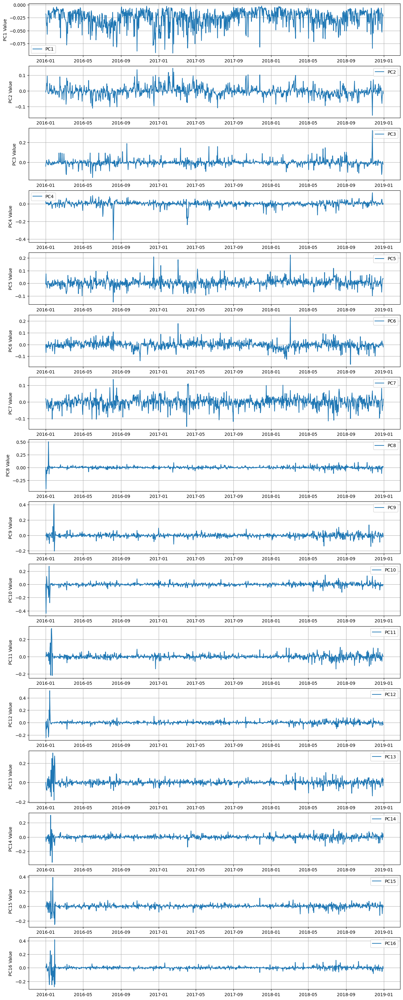

In [220]:
n_components = 16 #number of PCs chosen (16)

#The first 16 principal components (eigenvectors)
pcs = eigenVectors[:, 0:n_components]

#dates for the x-axis
dates = pd.date_range(start='2016-01-01', periods=1095)

# Create subplots
fig, axs = plt.subplots(n_components, figsize=(15, 40))

for i in range(n_components):
    axs[i].plot(dates, pcs[:, i], label=f'PC{i+1}')
    axs[i].set_ylabel(f'PC{i+1} Value')
    axs[i].grid(True)
    axs[i].legend()

#plt.xlabel('Date')
#plt.tight_layout()
plt.show()

Part 2) - 6
---
___
Compare the first few PCs with the rest of them. Do you see any difference in their trend?
___
The first few PCs have a lot of motion/movement which means they capture the most variability in the dataset. The PCs that capture majority of the data are PCs 1 - 7. PCs 8-16 have less movement and are more "flat". This means that they capture less variability in the dataset and are not as important in analyzing the dataset.
___

# Part 3: Data reconstruction [4.5 Marks]

Create a function that:

*   Accepts a destination state and the original dataset as inputs.
*   Calls useful functions that you designed in previous parts to compute eigenvectors and eigenvalues.
*   Plots 4 figures:
  1.   The original time-series for the specified state. **[0.5]**
  2.   The incremental reconstruction of the **original** (not standardized) time-series for the specified state in a single plot. **[1.5]**
       * You should show 4 curves in a figure for incremental reconstruction by picking the following combinations:
          * Reconstruction with only PC1
          * Reconstruction with both PC1 and PC2
          * Reconstruction with PC1 to PC4 (First 4 PCs)
          * Reconstruction with PC1 to PC6 (First 6 PCs)

      * Hint: you need to compute the reconstruction for the standardized time-series first, and then scale it back to the original (non-standardized form) using the StandardScaler `inverse_transform` [help...](https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.StandardScaler.html#sklearn.preprocessing.StandardScaler.inverse_transform)
  3.   The residual error for your best reconstruction with respect to the original time-series. **[1]**
      * Hint: You are plotting the error that we have for reconstructing each day `(df - df_reconstructed)`. On the x-axis, you have dates, and on the y-axis, the residual error.
  4.   The RMSE of the reconstruction as a function of the number of included components (x-axis is the number of components and y-axis is the RMSE). Sweep x-axis from 1 to 7 (this part is independent from part 3.2.) **[1]**

Test your function using the `AZ`, `CA`, `IL` and `NC` as inputs. **[0.5]**


working code below.

New working code.
---

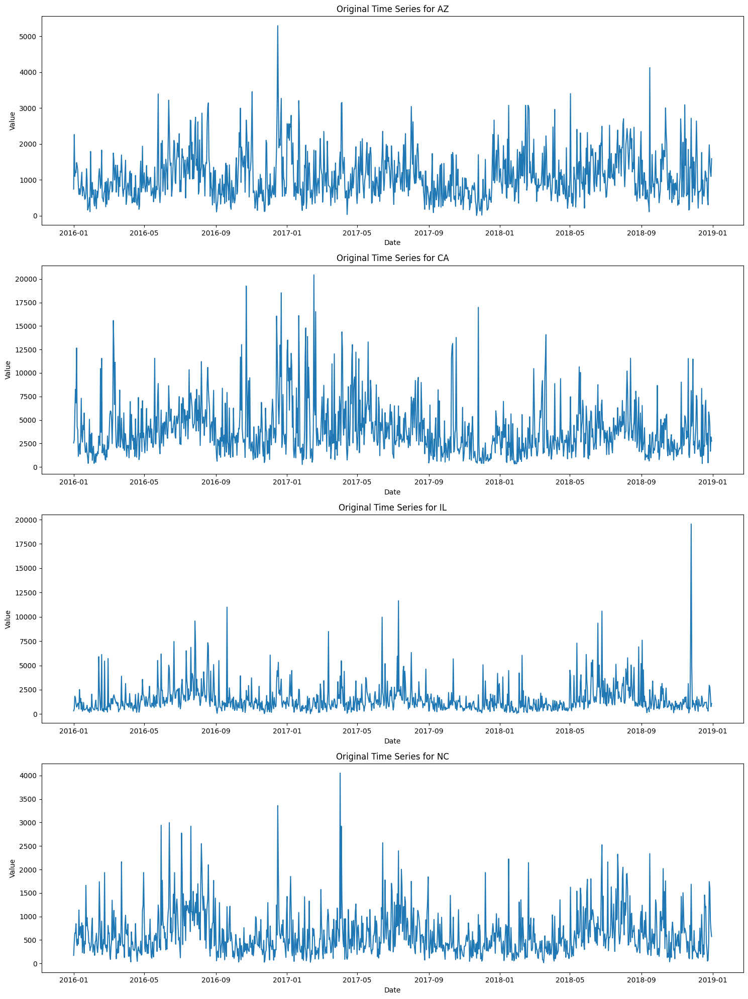

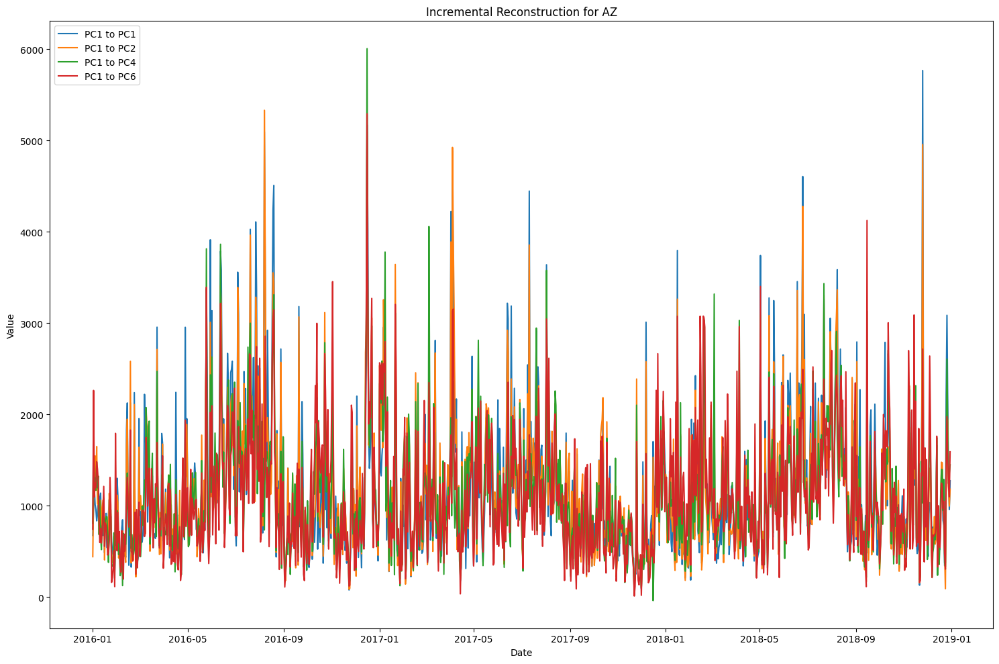

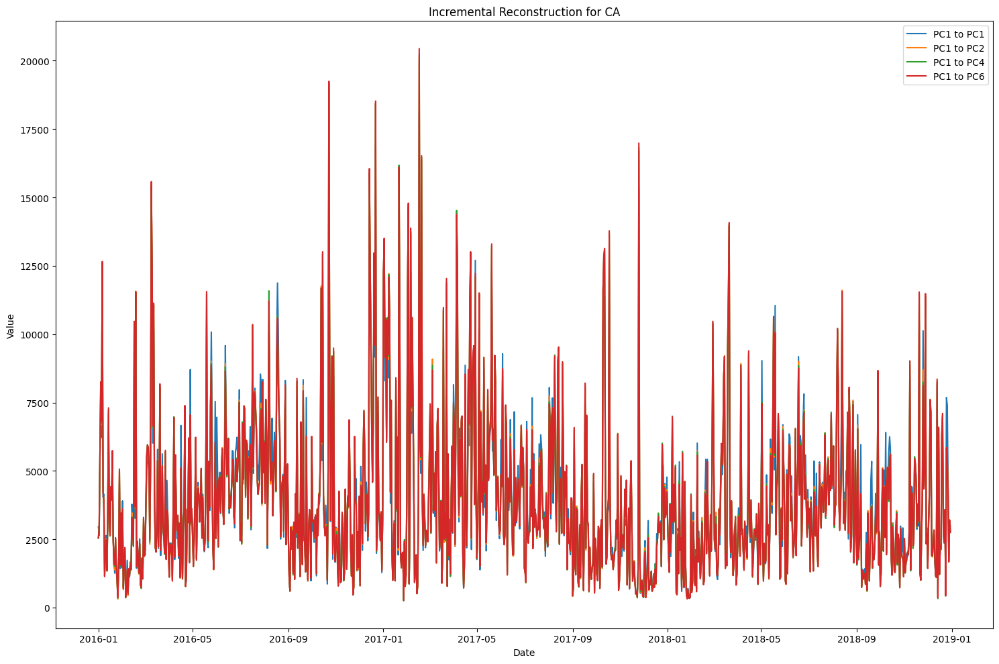

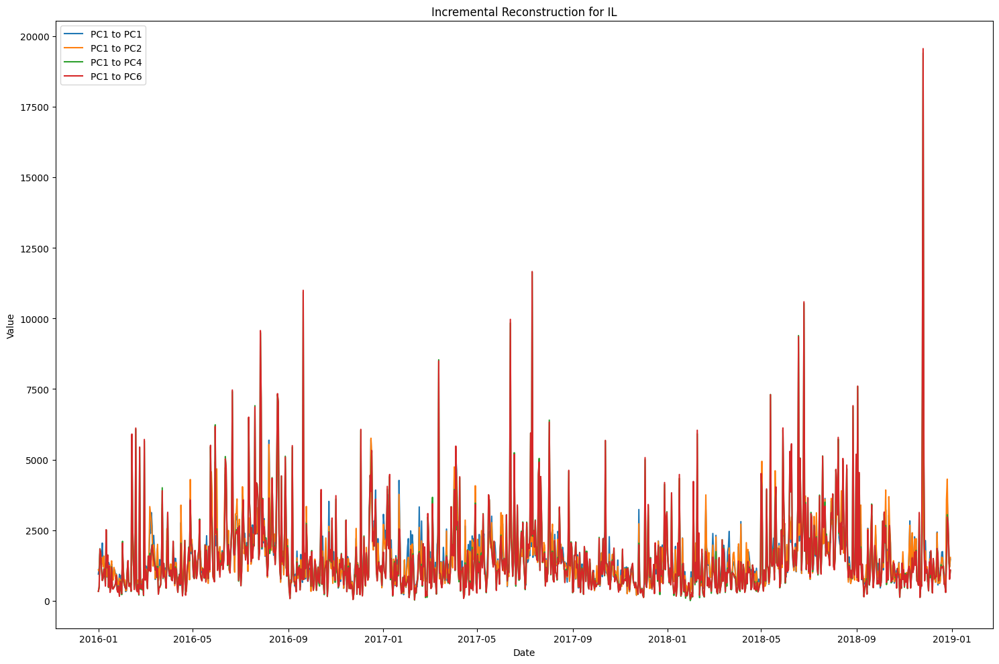

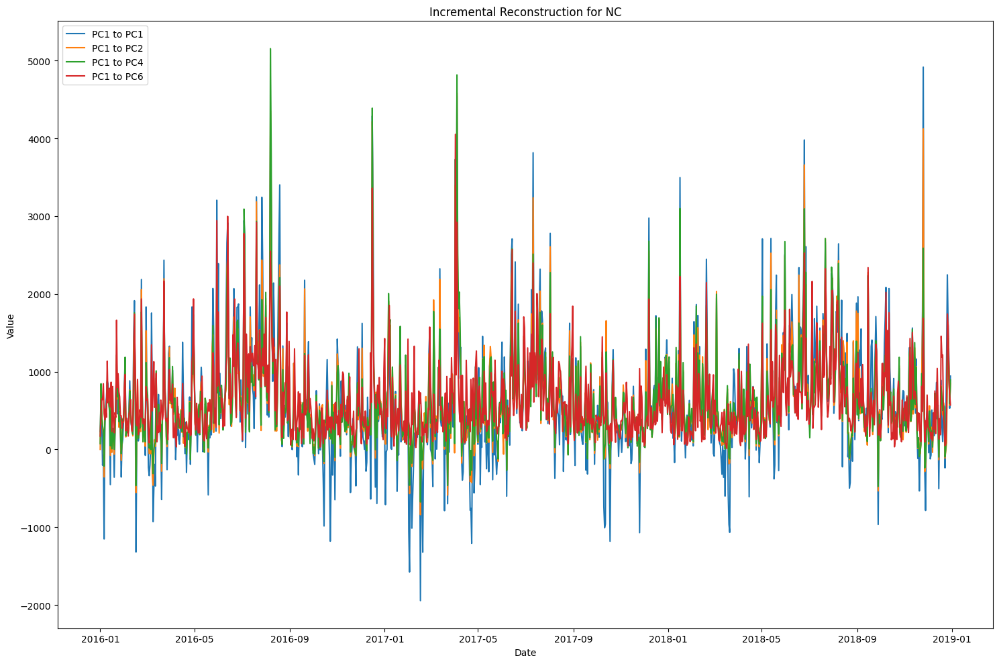

...

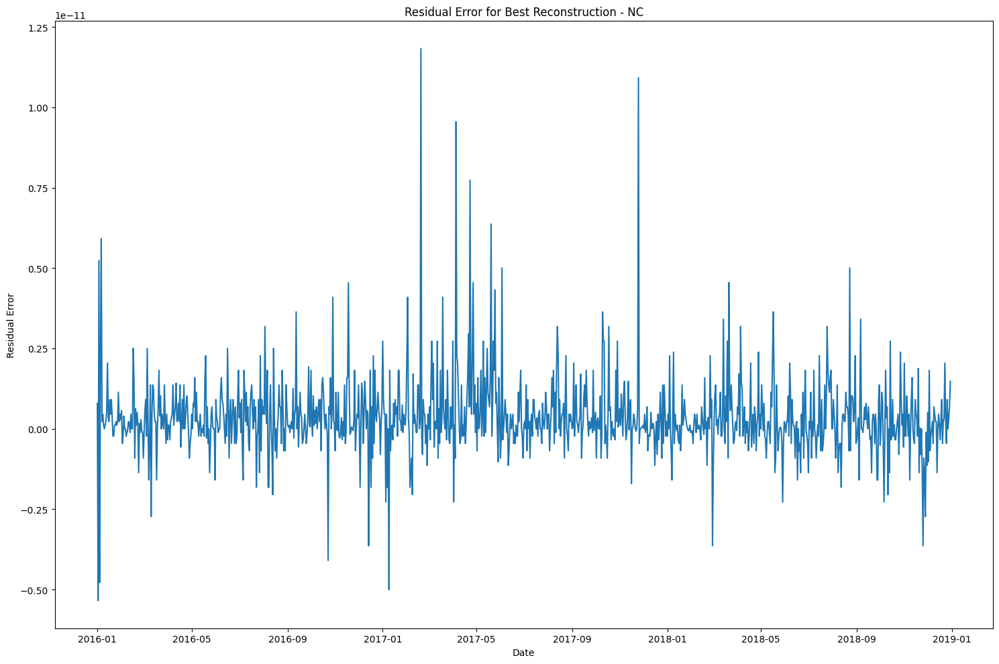

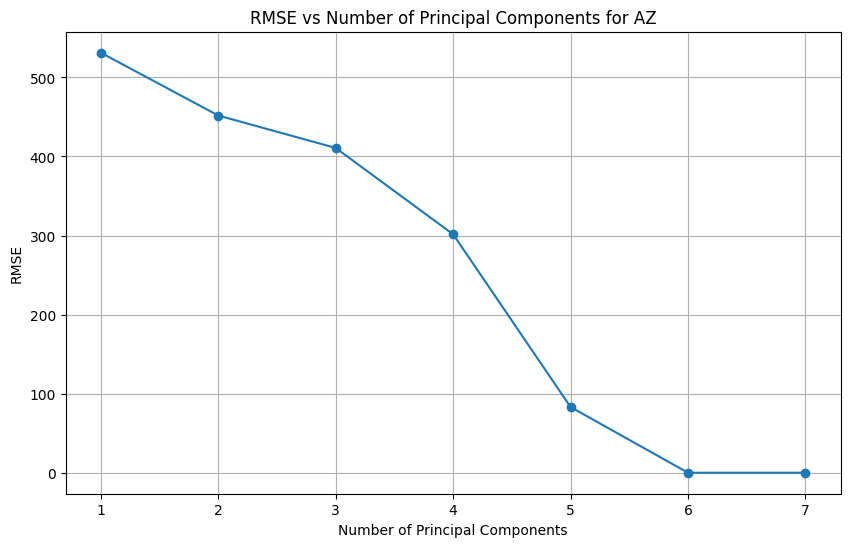

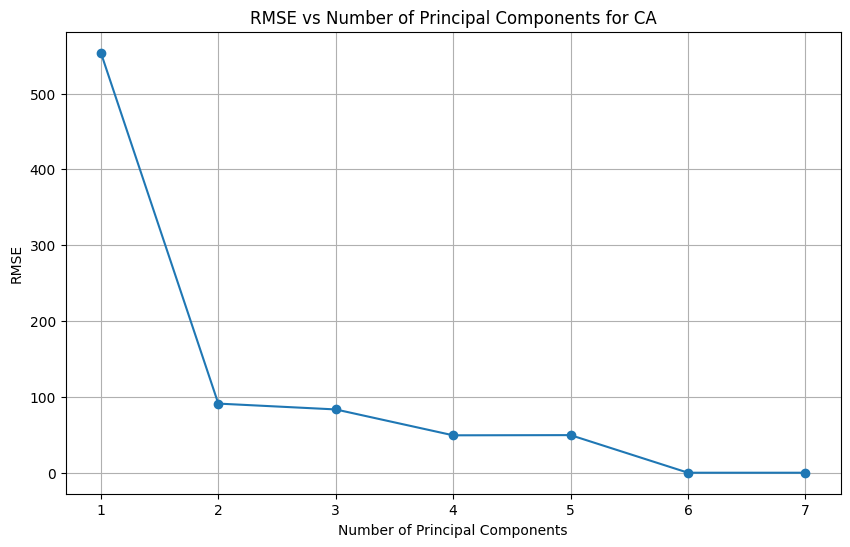

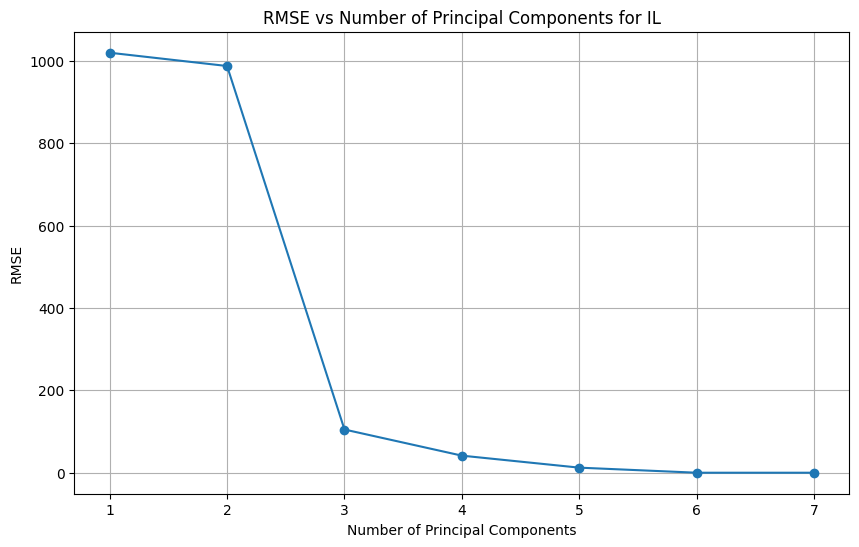

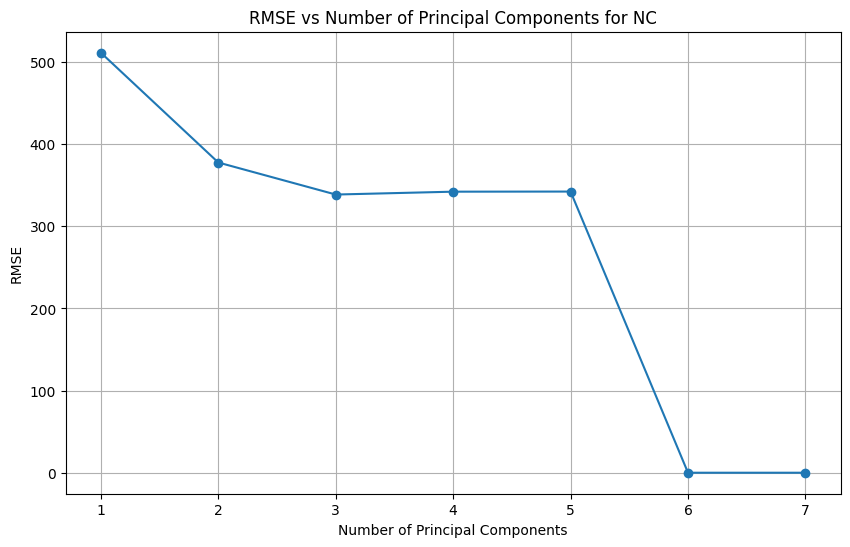

In [221]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error

original_df = data_raw
eigenValues, eigenVectors = get_sorted_eigen(df_cov)

def plot_state_figures(original_df, state_names):
    scaler = StandardScaler()
    STD_original_df = scaler.fit_transform(original_df)
    STD_original_df = pd.DataFrame(STD_original_df, index=original_df.index, columns=original_df.columns)

    cov_STD_original_df = np.cov(STD_original_df.T)
    eigenValues, eigenVectors = get_sorted_eigen(cov_STD_original_df)

    # Create date range
    dates = pd.date_range(start='2016-01-01', periods=1095)

    # Figure 1: Original time-series
    plt.figure(figsize=(15, 5 * len(state_names)))
    for i, state in enumerate(state_names, 1):
        plt.subplot(len(state_names), 1, i)
        plt.plot(dates, original_df.loc[state])
        plt.title(f'Original Time Series for {state}')
        plt.ylabel('Value')
        plt.xlabel('Date')
    plt.tight_layout()
    plt.show()

    # Figure 2: Incremental reconstruction
    PCs_range = [1,2,4,6]

    for state in state_names:
        plt.figure(figsize=(15, 10))

        for PC_count in PCs_range:
            W = eigenVectors[:, :PC_count]
            projx = np.dot(STD_original_df, W)
            ReconX = projx.dot(W.T)
            reconstructed_df = pd.DataFrame(scaler.inverse_transform(ReconX), index=original_df.index,columns=original_df.columns)
            plt.plot(dates, reconstructed_df.loc[state], label=f'PC1 to PC{PC_count}')

        plt.title(f'Incremental Reconstruction for {state}')
        plt.ylabel('Value')
        plt.xlabel('Date')
        plt.legend()
        plt.tight_layout()
        plt.show()

    #Figure 3: The residual error of the best reconstruction with respect to the original time-series
    for state in state_names:
          plt.figure(figsize=(15, 10))

          df_reconstructed = []

          for PC_count in PCs_range:
              W = eigenVectors[:, :PC_count]
              projx = np.dot(STD_original_df, W)
              ReconX = projx.dot(W.T)
              reconstructed_df = pd.DataFrame(scaler.inverse_transform(ReconX), index=original_df.index,columns=original_df.columns)
              error = ((original_df.loc[state] - reconstructed_df.loc[state]) ** 2).mean()
              df_reconstructed = reconstructed_df.loc[state]

          residual_error = original_df.loc[state] - df_reconstructed

          plt.plot(dates, residual_error)
          plt.title(f'Residual Error for Best Reconstruction - {state}')
          plt.ylabel('Residual Error')
          plt.xlabel('Date')
          plt.tight_layout()
          plt.show()

# Figure 4: RMSE vs Number of Components
    max_components = 7
    rmse_values = {state: [] for state in state_names}

    for PC_count in range(1, max_components + 1):
        W = eigenVectors[:, :PC_count]
        projx = STD_original_df.dot(W)
        ReconX = projx.dot(W.T)
        reconstructed_df = pd.DataFrame(scaler.inverse_transform(ReconX),index=original_df.index, columns=original_df.columns)

        for state in state_names:
            original_df.loc[state] = original_df.loc[state]
            rmse = np.sqrt(mean_squared_error(original_df.loc[state], reconstructed_df.loc[state]))
            rmse_values[state].append(rmse)

    for state in state_names:
        plt.figure(figsize=(10, 6))
        plt.plot(range(1, max_components + 1), rmse_values[state], marker='o')
        plt.title(f'RMSE vs Number of Principal Components for {state}')
        plt.xlabel('Number of Principal Components')
        plt.ylabel('RMSE')
        plt.grid(True)
        plt.show()

# Call the function with multiple states
plot_state_figures(original_df, ['AZ', 'CA', 'IL', 'NC'])

OLD CODE
---

# Part 4: SVD [2 Marks]
Modify your code in part 3 to use SVD instead of PCA. **[1]**

Explain if standardization or covariance computation is required for this part.
Repeat part 3 and compare your PCA and SVD results. Write a function to make this comparison **[0.5]**, and comment on the results. **[0.5]**.

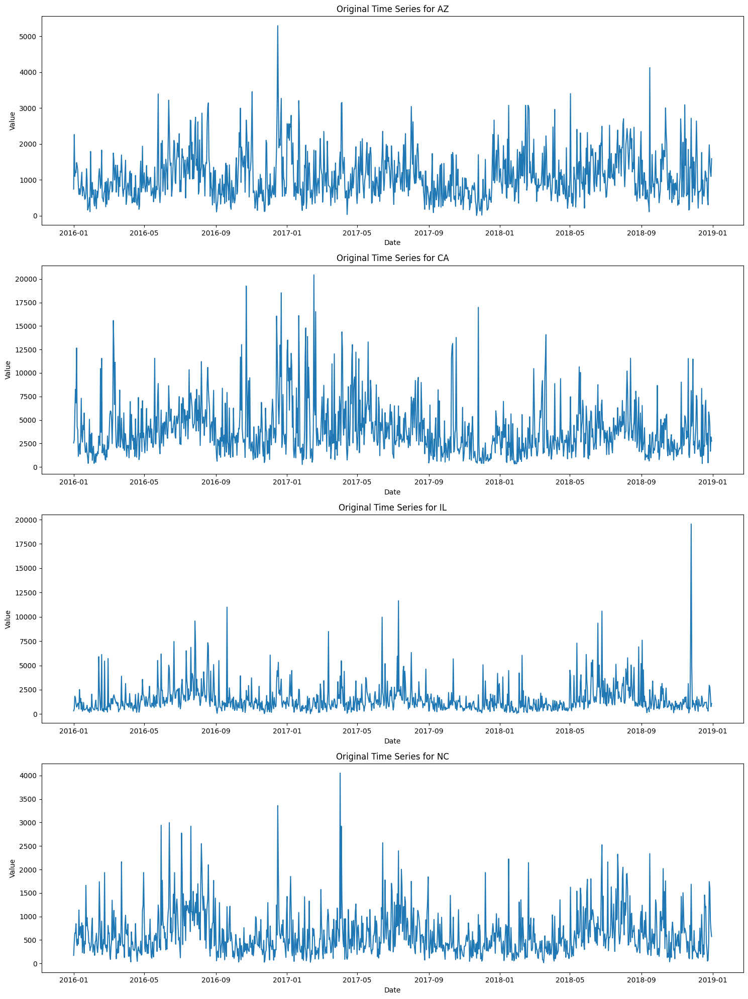

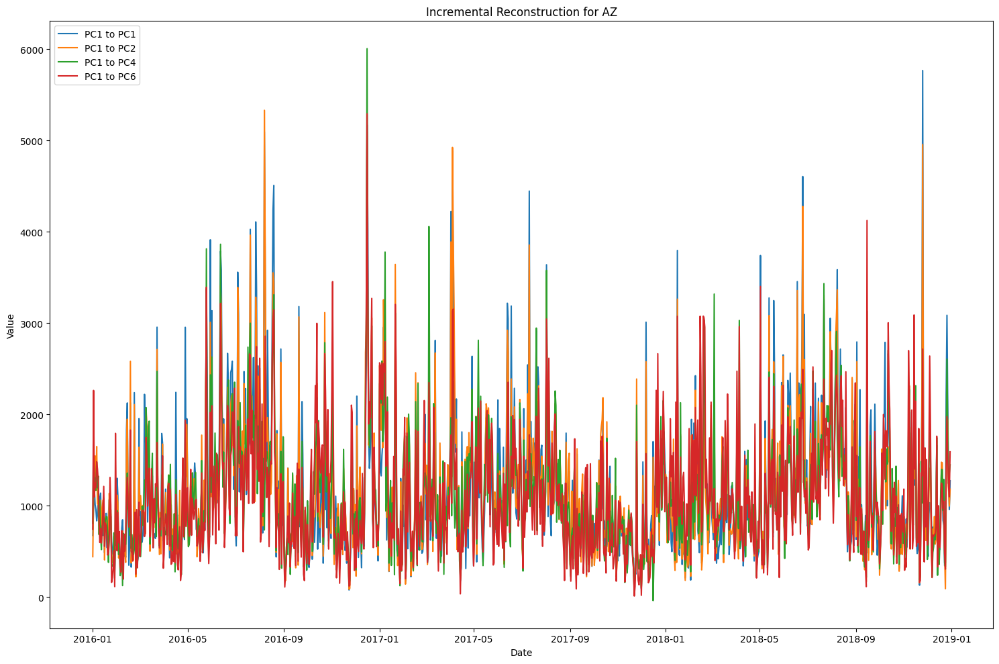

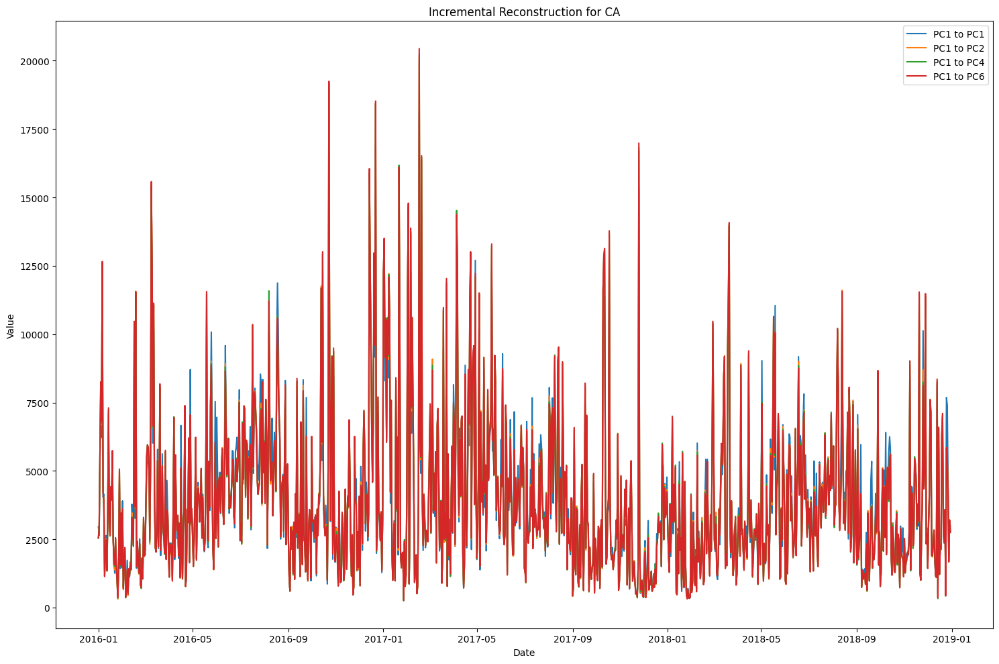

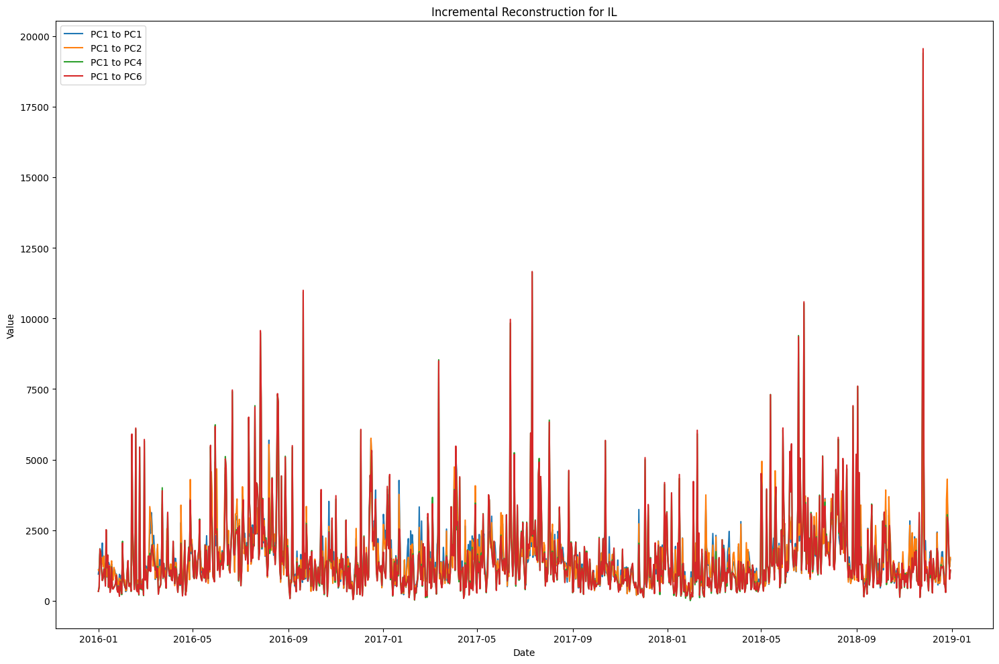

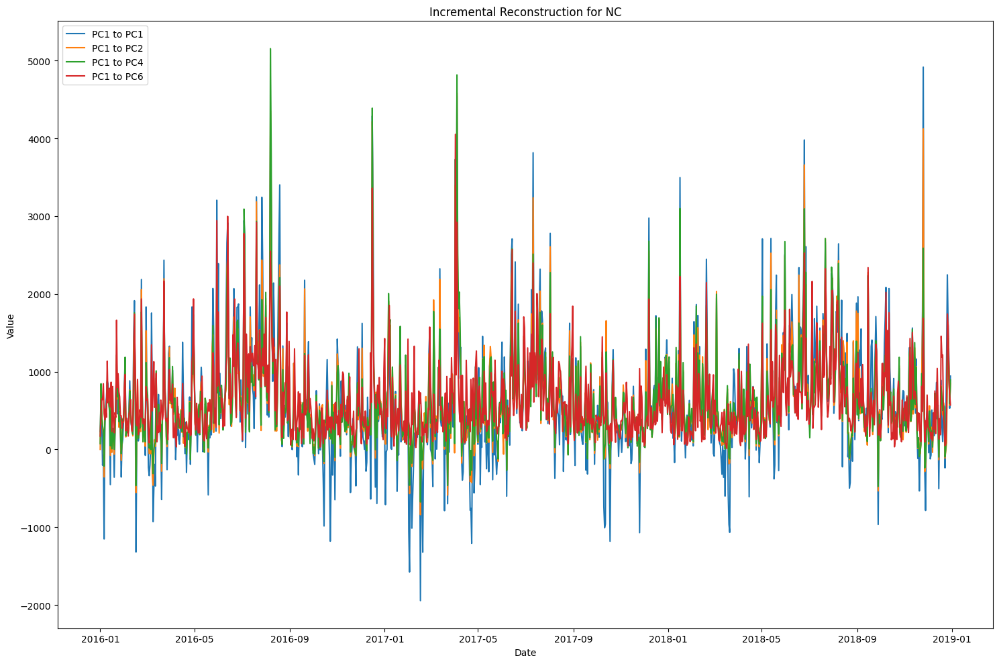

...

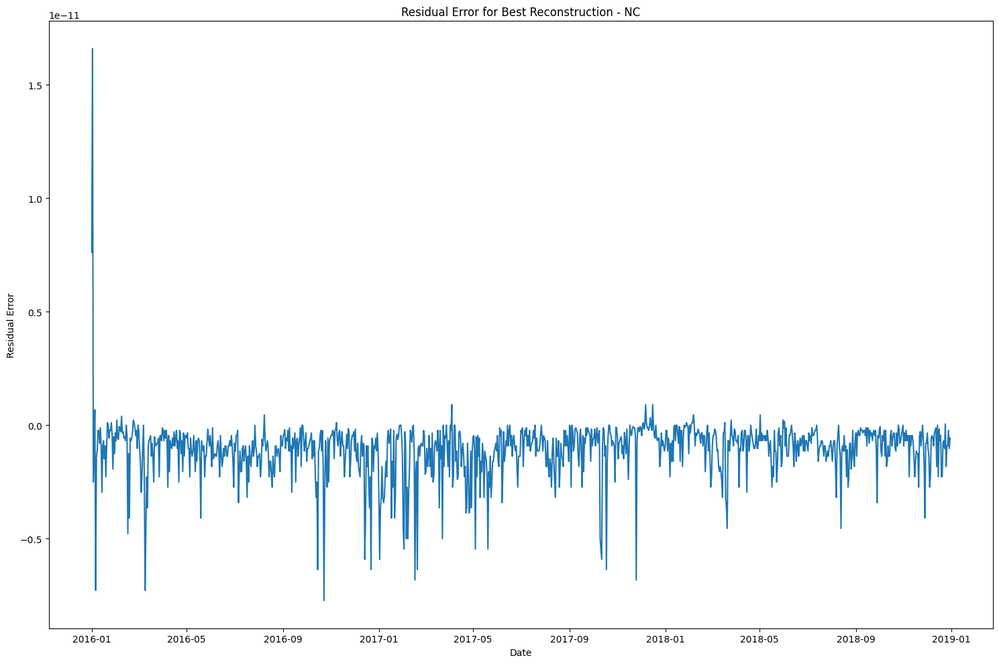

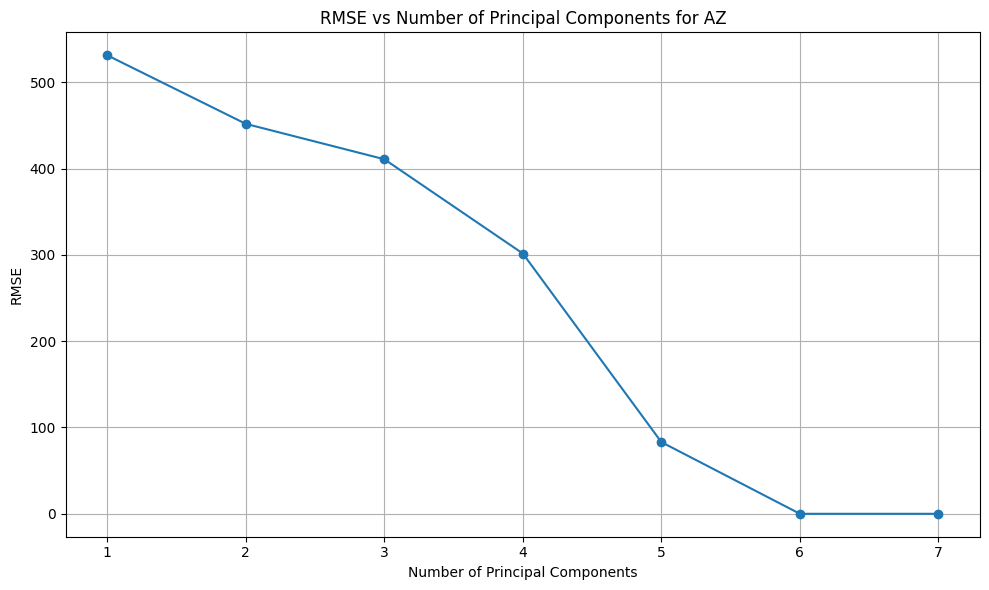

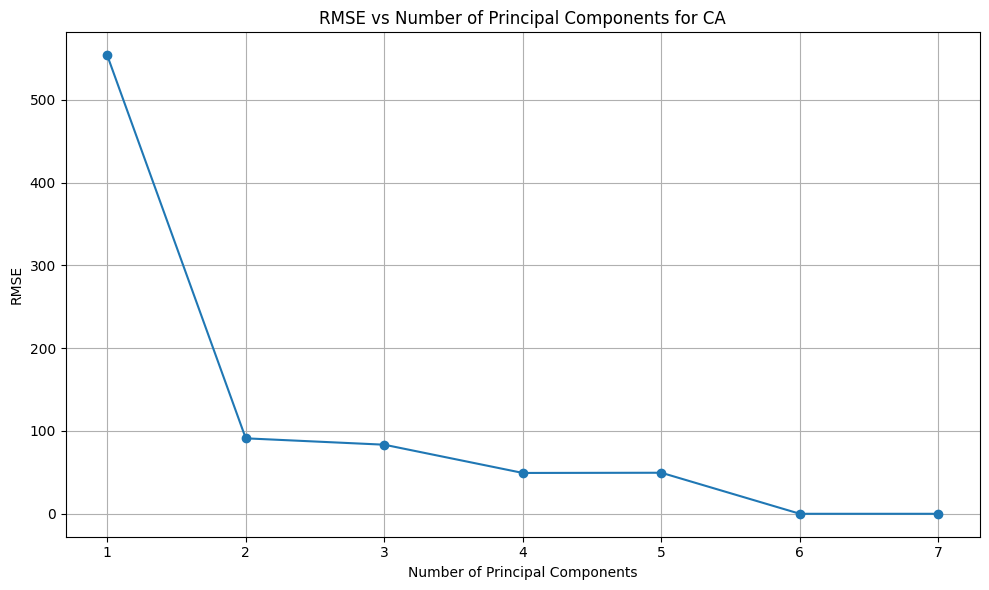

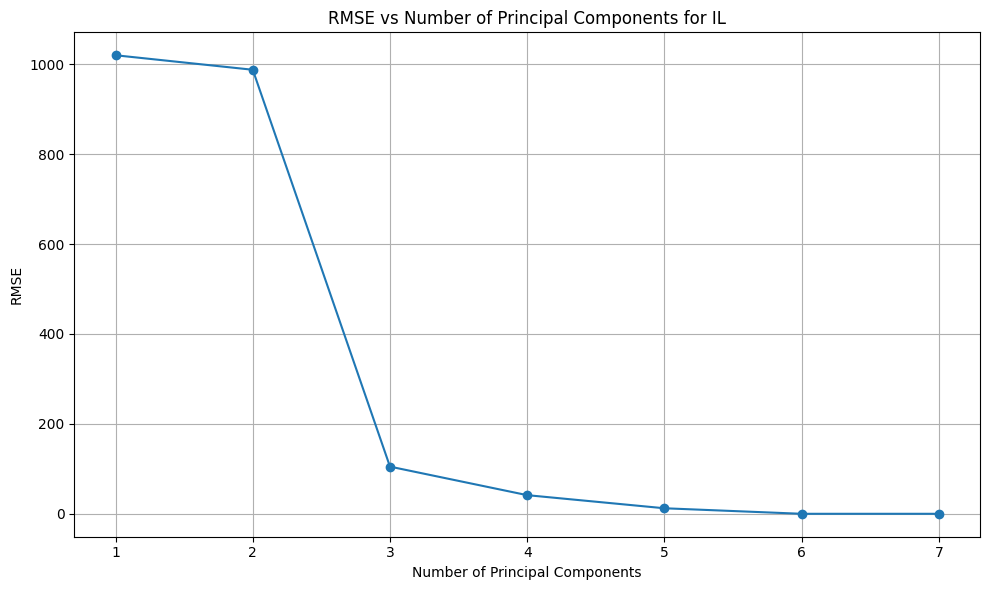

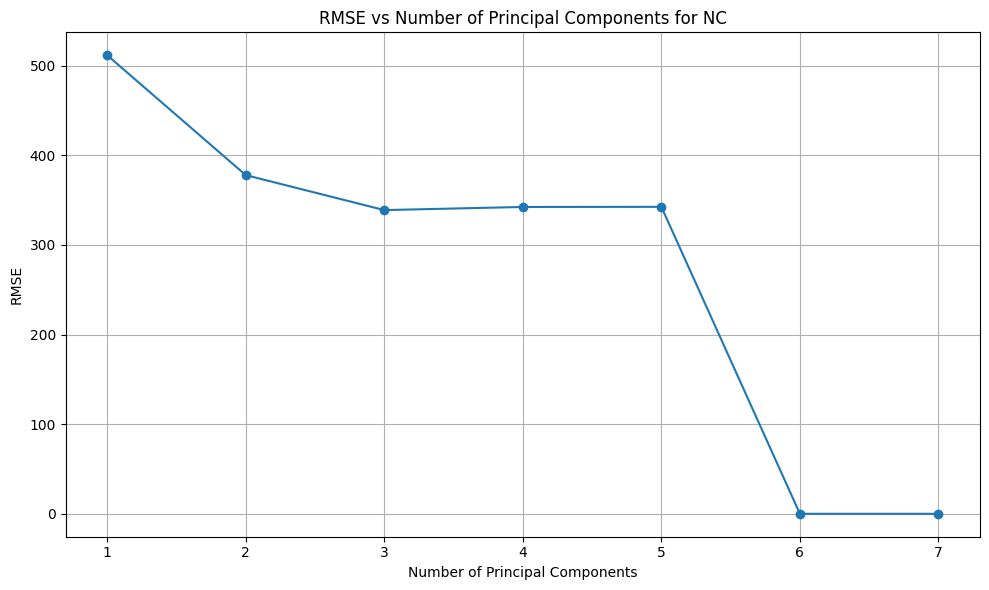

In [222]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error

original_df = data_raw
scaler = StandardScaler()
STD_original_df = scaler.fit_transform(original_df)
STD_original_df = pd.DataFrame(STD_original_df, index=original_df.index, columns=original_df.columns)

# Function to perform SVD and return components
def svd_C(STD_original_df):
    U, s, V = np.linalg.svd(STD_original_df, full_matrices=False)
    return U, s, V

def plot_state_figures_2(original_df, state_names):
    # Get SVD components
    U, s, V = svd_C(STD_original_df)

    # Create date range
    dates = pd.date_range(start='2016-01-01', periods=1095)

    # Figure 1: Original time-series
    plt.figure(figsize=(15, 5 * len(state_names)))
    for i, state in enumerate(state_names, 1):
        plt.subplot(len(state_names), 1, i)
        plt.plot(dates, original_df.loc[state])
        plt.title(f'Original Time Series for {state}')
        plt.ylabel('Value')
        plt.xlabel('Date')
    plt.tight_layout()
    plt.show()

    # Figure 2: Incremental reconstruction
    PCs_range = [1, 2, 4, 6]

    for state in state_names:
        plt.figure(figsize=(15, 10))

        for PC_count in PCs_range:
            W = V[:PC_count, :].T
            projx = np.dot(STD_original_df, W)
            ReconX = np.dot(projx, W.T)
            reconstructed_df = pd.DataFrame(scaler.inverse_transform(ReconX), index=original_df.index, columns=original_df.columns)
            plt.plot(dates, reconstructed_df.loc[state], label=f'PC1 to PC{PC_count}')



        plt.title(f'Incremental Reconstruction for {state}')
        plt.ylabel('Value')
        plt.xlabel('Date')
        plt.legend()
        plt.tight_layout()
        plt.show()

    # Figure 3: Residual Error of the best reconstruction
    for state in state_names:
        plt.figure(figsize=(15, 10))

        df_reconstructed =[]

        for PC_count in PCs_range:
            W = V[:PC_count, :].T
            projx = np.dot(STD_original_df, W)
            ReconX = np.dot(projx, W.T)
            reconstructed_df = pd.DataFrame(scaler.inverse_transform(ReconX), index=original_df.index,columns=original_df.columns)
            error = ((original_df.loc[state] - reconstructed_df.loc[state]) ** 2).mean()
            df_reconstructed = reconstructed_df.loc[state]

        residual_error = original_df.loc[state] - df_reconstructed

        plt.plot(dates, residual_error)
        plt.title(f'Residual Error for Best Reconstruction - {state}')
        plt.ylabel('Residual Error')
        plt.xlabel('Date')
        plt.tight_layout()
        plt.show()

    # Figure 4: RMSE vs Number of Components
    max_components = 7
    rmse_values = {state: [] for state in state_names}

    for PC_count in range(1, max_components + 1):
        W = V[:PC_count, :].T
        projx = np.dot(STD_original_df, W)
        ReconX = np.dot(projx, W.T)
        reconstructed_df = pd.DataFrame(scaler.inverse_transform(ReconX), index=original_df.index, columns=original_df.columns)

        for state in state_names:
            rmse = np.sqrt(mean_squared_error(original_df.loc[state], reconstructed_df.loc[state]))
            rmse_values[state].append(rmse)

    for state in state_names:
        plt.figure(figsize=(10, 6))
        plt.plot(range(1, max_components + 1), rmse_values[state], marker='o')
        plt.title(f'RMSE vs Number of Principal Components for {state}')
        plt.xlabel('Number of Principal Components')
        plt.ylabel('RMSE')
        plt.grid(True)
        plt.tight_layout()
        plt.show()

# Call the function with multiple states
plot_state_figures_2(original_df, ['AZ', 'CA', 'IL', 'NC'])


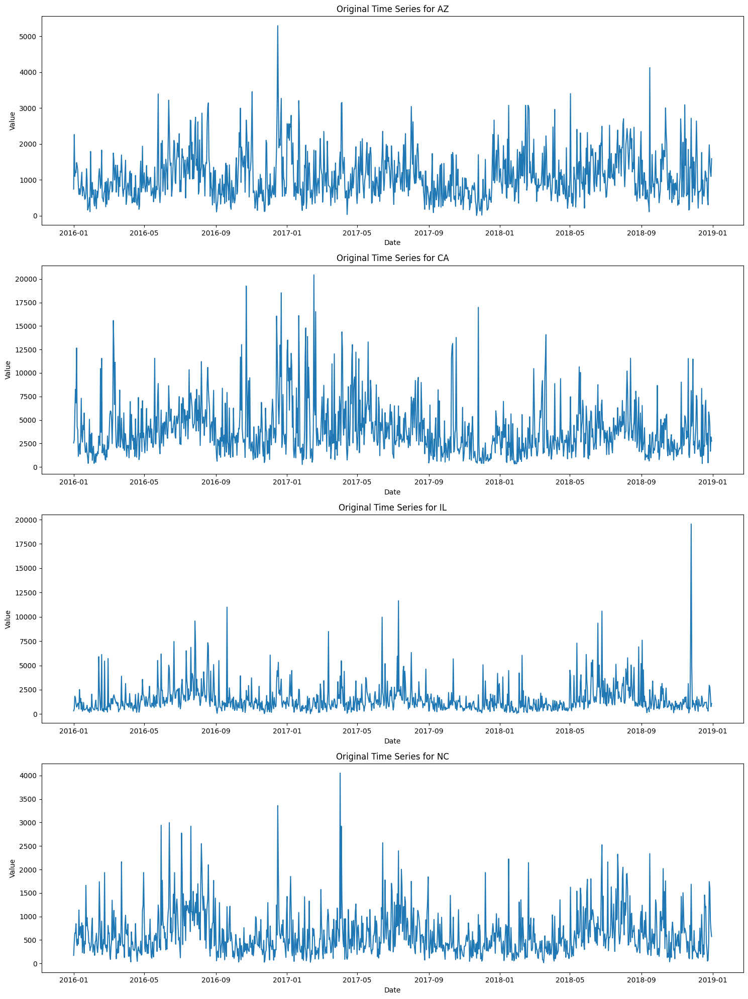

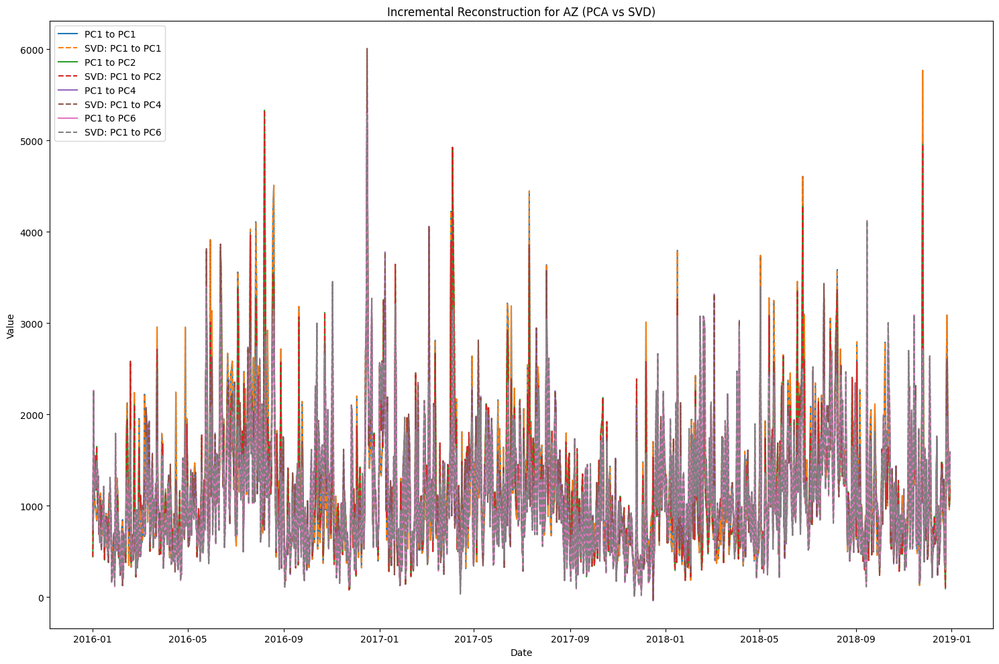

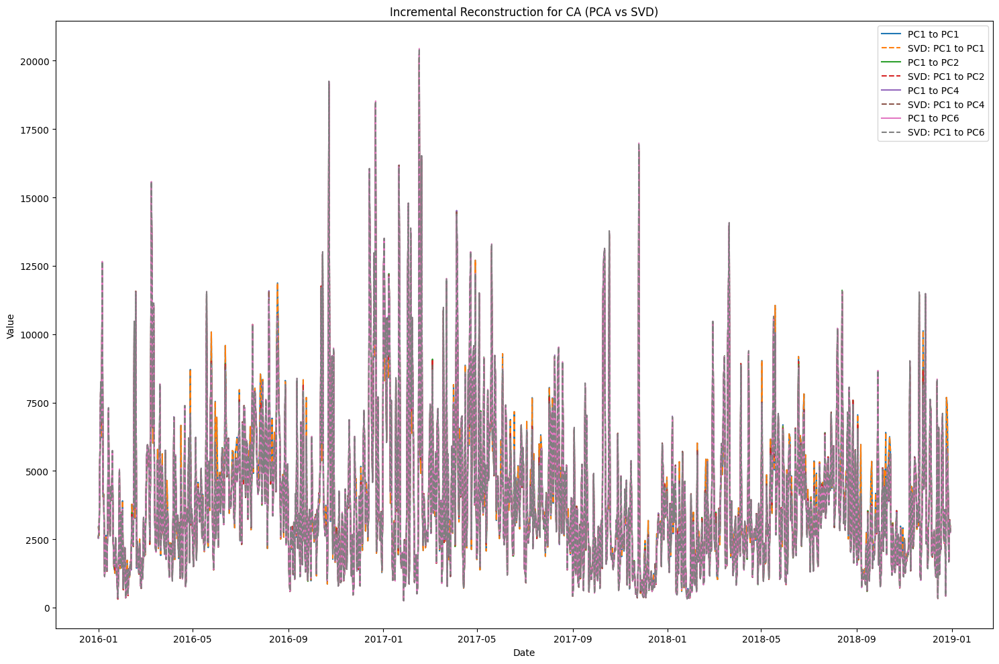

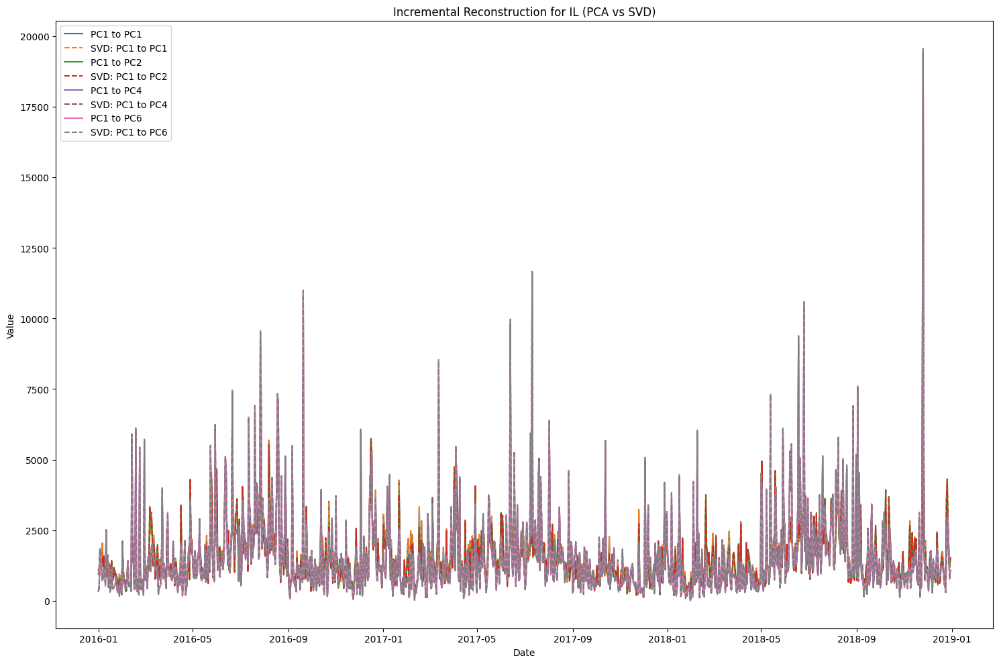

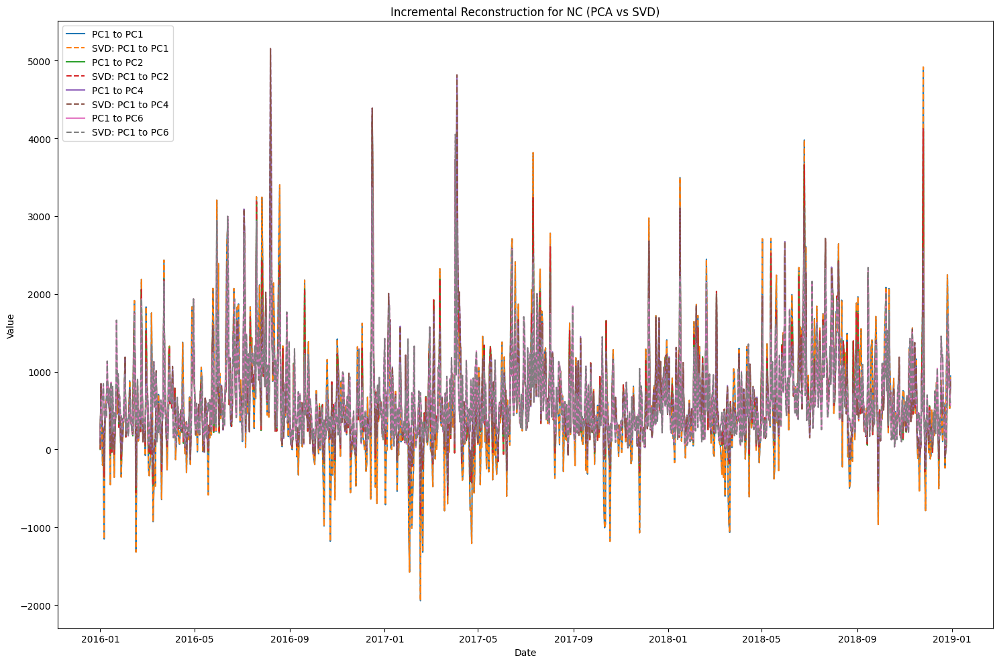

...

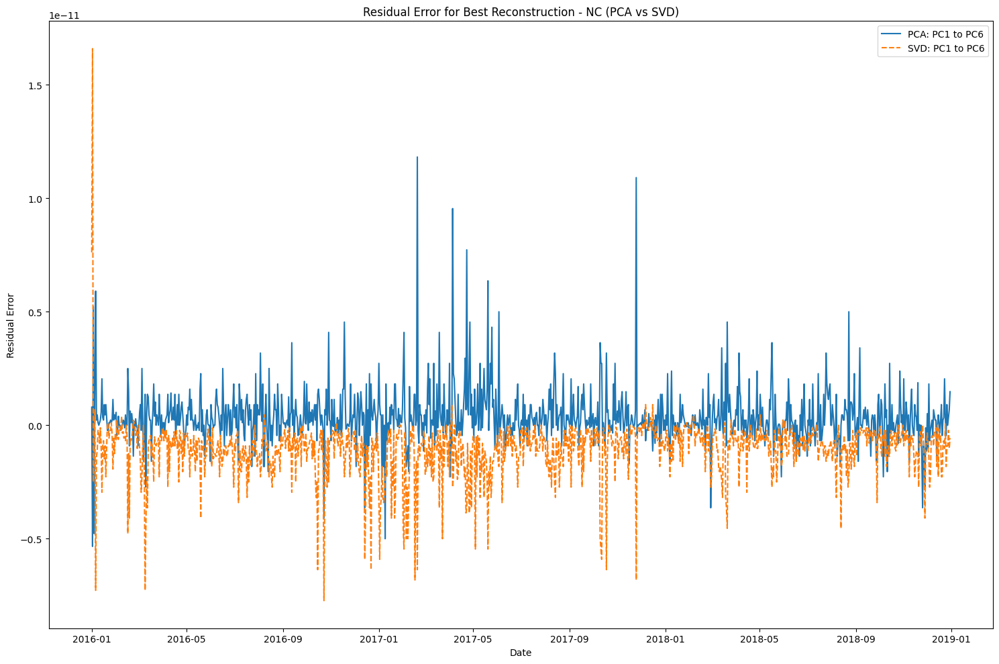

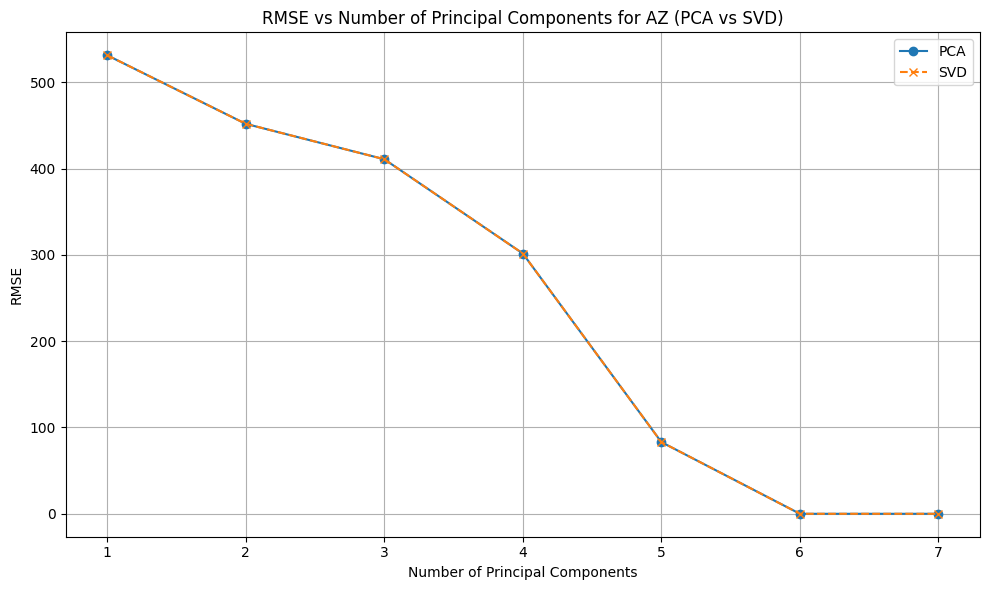

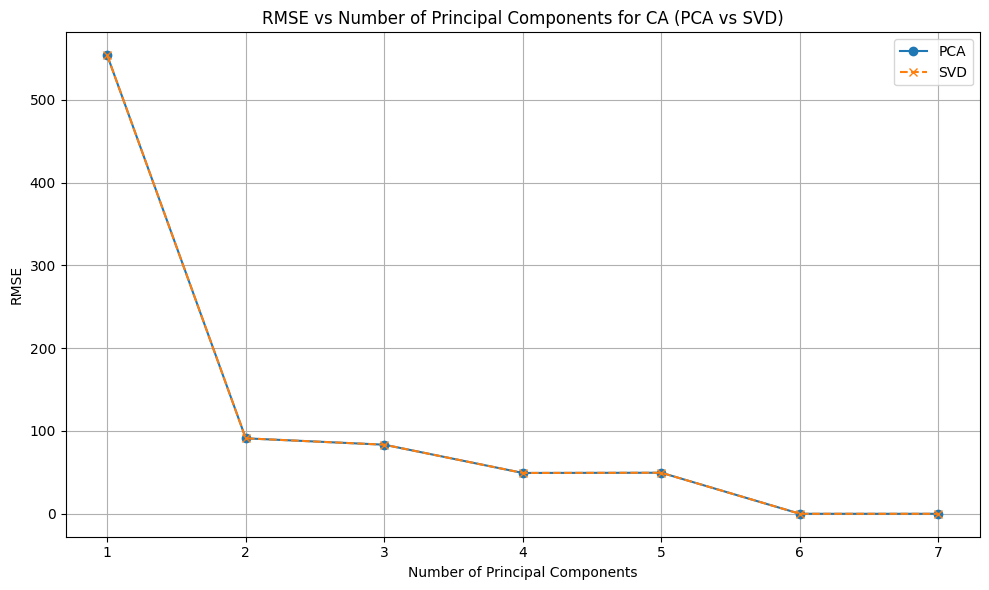

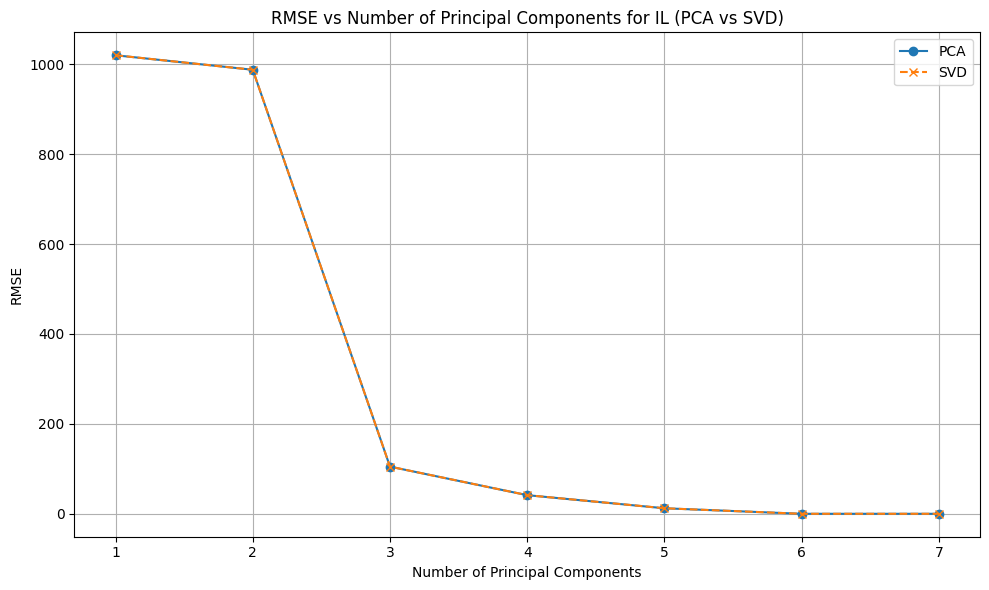

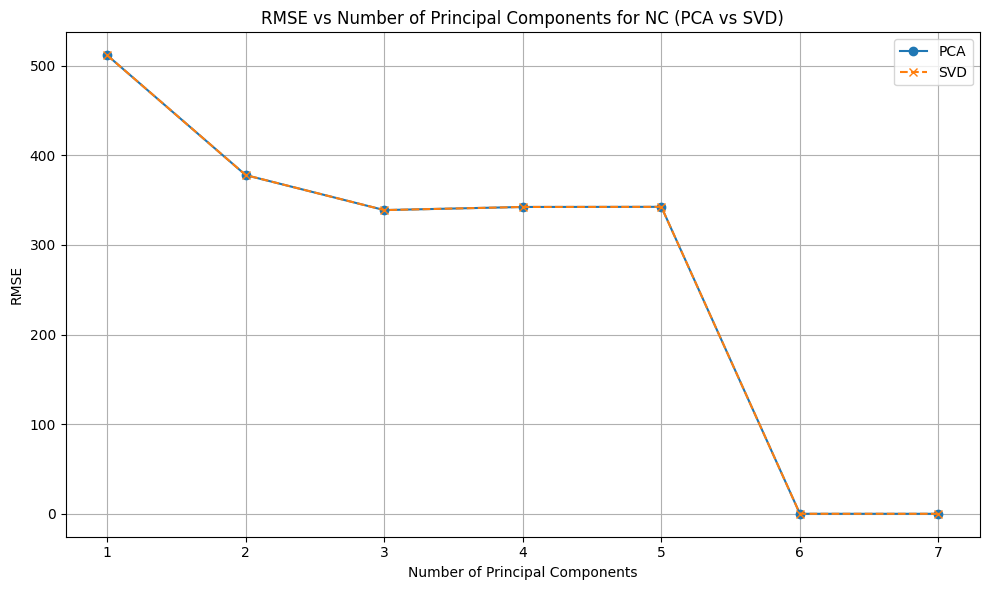

In [223]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error

eigenValues, eigenVectors = get_sorted_eigen(df_cov)

def svd_C(STD_original_df):
    U, s, V = np.linalg.svd(STD_original_df, full_matrices=False)
    return U, s, V

def plot_state_figures(original_df, state_names):

    scaler = StandardScaler()
    STD_original_df = scaler.fit_transform(original_df)
    STD_original_df = pd.DataFrame(STD_original_df, index=original_df.index, columns=original_df.columns)

    cov_STD_original_df = np.cov(STD_original_df.T)
    eigenValues, eigenVectors = get_sorted_eigen(cov_STD_original_df)

    dates = pd.date_range(start='2016-01-01', periods=1095)

    # Figure 1: Original time-series
    plt.figure(figsize=(15, 5 * len(state_names)))
    for i, state in enumerate(state_names, 1):
        plt.subplot(len(state_names), 1, i)
        plt.plot(dates, original_df.loc[state])
        plt.title(f'Original Time Series for {state}')
        plt.ylabel('Value')
        plt.xlabel('Date')
    plt.tight_layout()
    plt.show()

    # Figures 2: Incremental Reconstruction (PCA and SVD)
    PCs_range = [1, 2, 4, 6]

    for state in state_names:
        plt.figure(figsize=(15, 10))

        for PC_count in PCs_range:
            W_pca = eigenVectors[:, :PC_count]
            projx = np.dot(STD_original_df, W_pca)
            ReconX = projx.dot(W_pca.T)
            reconstructed_df = pd.DataFrame(scaler.inverse_transform(ReconX), index=original_df.index,columns=original_df.columns)
            plt.plot(dates, reconstructed_df.loc[state], label=f'PC1 to PC{PC_count}')

            U, s, V = svd_C(STD_original_df)
            W = V[:PC_count, :].T
            projx_svd = np.dot(STD_original_df, W)
            ReconX_svd = np.dot(projx_svd, W.T)
            reconstructed_df_svd = pd.DataFrame(scaler.inverse_transform(ReconX_svd), index=original_df.index, columns=original_df.columns)
            plt.plot(dates, reconstructed_df_svd.loc[state], linestyle='--', label=f'SVD: PC1 to PC{PC_count}')

        plt.title(f'Incremental Reconstruction for {state} (PCA vs SVD)')
        plt.ylabel('Value')
        plt.xlabel('Date')
        plt.legend()
        plt.tight_layout()
        plt.show()

    # Figures 3: Residual Error (PCA and SVD)
    for state in state_names:
        plt.figure(figsize=(15, 10))


        for PC_count in PCs_range:

            W_pca = eigenVectors[:, :PC_count]
            projx_pca = np.dot(STD_original_df, W_pca)
            ReconX_pca = projx_pca.dot(W_pca.T)
            reconstructed_df_pca = pd.DataFrame(scaler.inverse_transform(ReconX_pca), index=original_df.index, columns=original_df.columns)




            U, s, V = svd_C(STD_original_df)
            W = V[:PC_count, :].T
            projx_svd = np.dot(STD_original_df, W)
            ReconX_svd = np.dot(projx_svd, W.T)
            reconstructed_df_svd = pd.DataFrame(scaler.inverse_transform(ReconX_svd), index=original_df.index, columns=original_df.columns)

        residual_error_pca = original_df.loc[state] - reconstructed_df_pca.loc[state]
        residual_error_svd = original_df.loc[state] - reconstructed_df_svd.loc[state]

        plt.plot(dates, residual_error_pca, label=f'PCA: PC1 to PC{PC_count}')
        plt.plot(dates, residual_error_svd, linestyle='--', label=f'SVD: PC1 to PC{PC_count}')
        plt.title(f'Residual Error for Best Reconstruction - {state} (PCA vs SVD)')
        plt.ylabel('Residual Error')
        plt.xlabel('Date')
        plt.legend()
        plt.tight_layout()
        plt.show()

    # Figures 4: RMSE vs Number of Components (PCA and SVD)
    max_components = 7
    rmse_values_pca = {state: [] for state in state_names}
    rmse_values_svd = {state: [] for state in state_names}

    for PC_count in range(1, max_components + 1):
        for state in state_names:

            W_pca = eigenVectors[:, :PC_count]
            projx_pca = STD_original_df.dot(W_pca)
            ReconX_pca = projx_pca.dot(W_pca.T)
            reconstructed_df_pca = pd.DataFrame(scaler.inverse_transform(ReconX_pca), index=original_df.index, columns=original_df.columns)
            rmse_pca = np.sqrt(mean_squared_error(original_df.loc[state], reconstructed_df_pca.loc[state]))
            rmse_values_pca[state].append(rmse_pca)


            U, s, V = svd_C(STD_original_df)
            W = V[:PC_count, :].T
            projx_svd = np.dot(STD_original_df, W)
            ReconX_svd = np.dot(projx_svd, W.T)
            reconstructed_df_svd = pd.DataFrame(scaler.inverse_transform(ReconX_svd), index=original_df.index, columns=original_df.columns)
            rmse_svd = np.sqrt(mean_squared_error(original_df.loc[state], reconstructed_df_svd.loc[state]))
            rmse_values_svd[state].append(rmse_svd)

    for state in state_names:
        plt.figure(figsize=(10, 6))
        plt.plot(range(1, max_components + 1), rmse_values_pca[state], marker='o', label='PCA')
        plt.plot(range(1, max_components + 1), rmse_values_svd[state], marker='x', linestyle='--', label='SVD')
        plt.title(f'RMSE vs Number of Principal Components for {state} (PCA vs SVD)')
        plt.xlabel('Number of Principal Components')
        plt.ylabel('RMSE')
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()


plot_state_figures(original_df, ['AZ', 'CA', 'IL', 'NC'])


Explain if standardization or covariance computation is required for this part. Repeat part 3 and compare your PCA and SVD results. Write a function to make this comparison [0.5], and comment on the results. [0.5].
---
___
Standardiazation is rqeuired for PCA as it ensures that the features are on the same scale by having the mean equal to 0 and STD equal to 1. Now for SVD, it depends on the data as it STD the data may not be required if the data has comparable scales across all the features however, it is good practice to STD the data. For covariance computation, depending on the data, SVD can be applied to the matrix directly.
___
When writing the code for both PCA and SVD, there typically should not be any difference when comparing the results and this is true in this case. Both PCA and SVD has the same RMSE value for all states. The values for residual error did in fact change depending on PCA or SVD however, the best residual error was always for the highest PC number.

# Part 5: Let's collect another dataset! [2.5 Marks]
Create another dataset similar to the one provided in your handout using the raw information on average flight delays for different cities of origin in the United States from 2017 to 2018 [here](https://github.com/Sabaae/Dataset/blob/main/AverageDelaysbyOrigin.csv). **[1]**


You need to manipulate the data to organize it in the desired format (i.e., the same format as the dataset in part 1).

You are free to use any tools you like, from Excel to Python! In the end, you should have a new CSV file similar to the previous dataset. How many features does the final dataset have? How many cities (ORIGIN airport codes) are there?


Upload your new dataset (in CSV format) to your colab notebook and repeat part 4 for this dataset **[1]**. For the incremental reconstruction section (part 3.2), this time consider the following combinations:
  * Reconstruction with only PC1
  * Reconstruction with both PC1 and PC2
  * Reconstruction with PC1 to PC4 (First 4 PCs)
  * Reconstruction with PC1 to PC6 (First 6 PCs)
  * Reconstruction with PC1 to PC8 (First 8 PCs)


Also for the reconstruction RMSE function (part 3.4), this time sweep the number of components (x-axis) from 1 to 8.


Comment on the results **[0.5]**. When analyzing the cities (airport codes), you may use`ATL`, `CLT`, `DFW`, `LAX`, and `PHX`.


The code below helps you to upload your new CSV file to your colab session.

In [224]:
# # load train.csv to Google Colab
# from google.colab import files
# uploaded = files.upload()

In [225]:
import pandas as pd
data_raw_1 = pd.read_csv(
    filepath_or_buffer='/content/AverageDelaysbyOrigin.csv',
    index_col=0
)

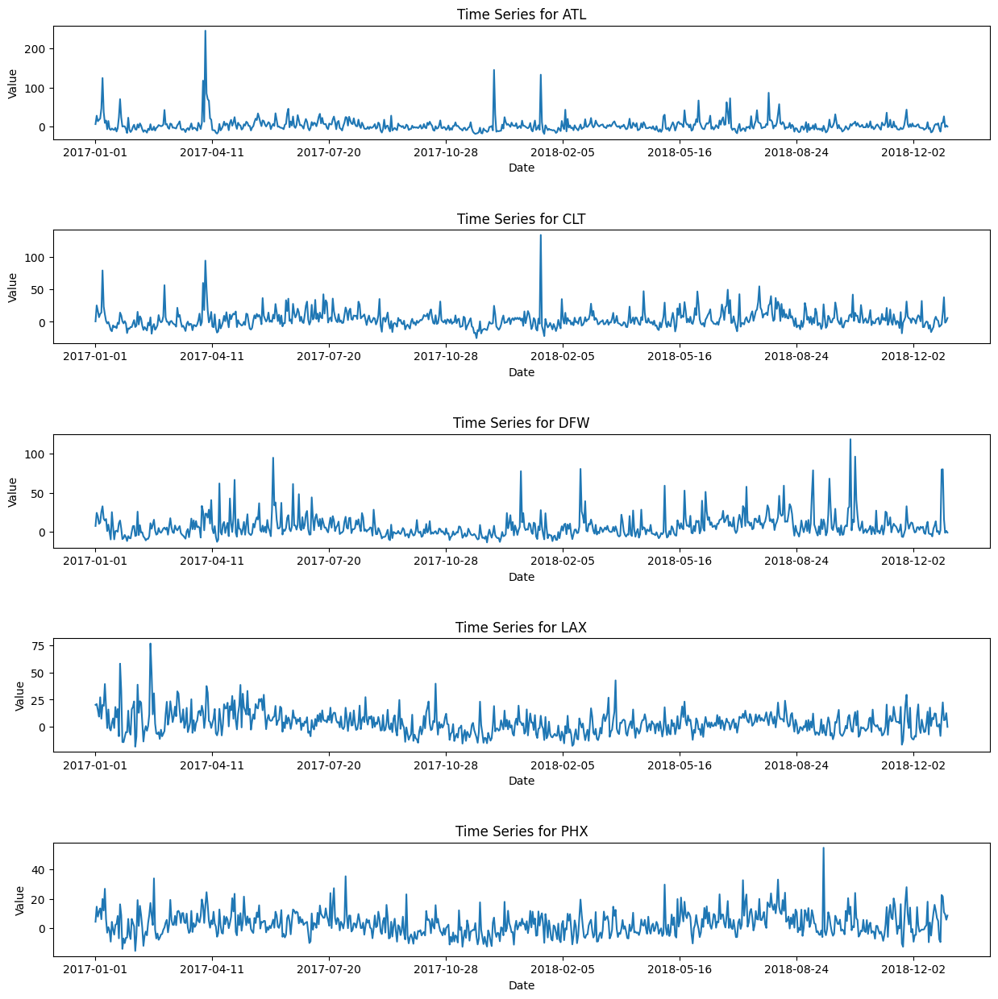

In [226]:
import matplotlib.pyplot as plt
def plot_time_series(data_raw_1, Origin):

    State_length = len(Origin) #lenght of the Origin in the data_raw
    plt.figure(figsize=(15, 15))
    for i, state in enumerate(Origin): #loops through all the Origin in the data_raw

        plt.subplot(State_length, 1, i + 1)

        data_raw_1.loc[state].plot()
        plt.title(f'Time Series for {state}')
        plt.ylabel('Value')
        plt.xlabel('Date')

    plt.subplots_adjust(hspace=0.8)
    plt.show()


plot_time_series(data_raw_1, ['ATL', 'CLT', 'DFW', 'LAX', 'PHX'])

In [227]:
from sklearn.preprocessing import StandardScaler

STD_data_raw = StandardScaler().fit_transform(data_raw_1) #STD the data_raw_1

STD_data_raw = pd.DataFrame(STD_data_raw, index=data_raw_1.index, columns=data_raw_1.columns)#put the data back into a df

In [228]:
#compute covariance matrix
df_cov = np.dot(data_raw_1.T, data_raw_1)/(n-1)
print("\n")

def get_sorted_eigen(df_cov):
    eigenValues, eigenVectors = np.linalg.eigh(df_cov)
    idx = np.argsort(-eigenValues)
    eigenValues = eigenValues[idx]
    eigenVectors = eigenVectors[:,idx]

    return eigenValues, eigenVectors



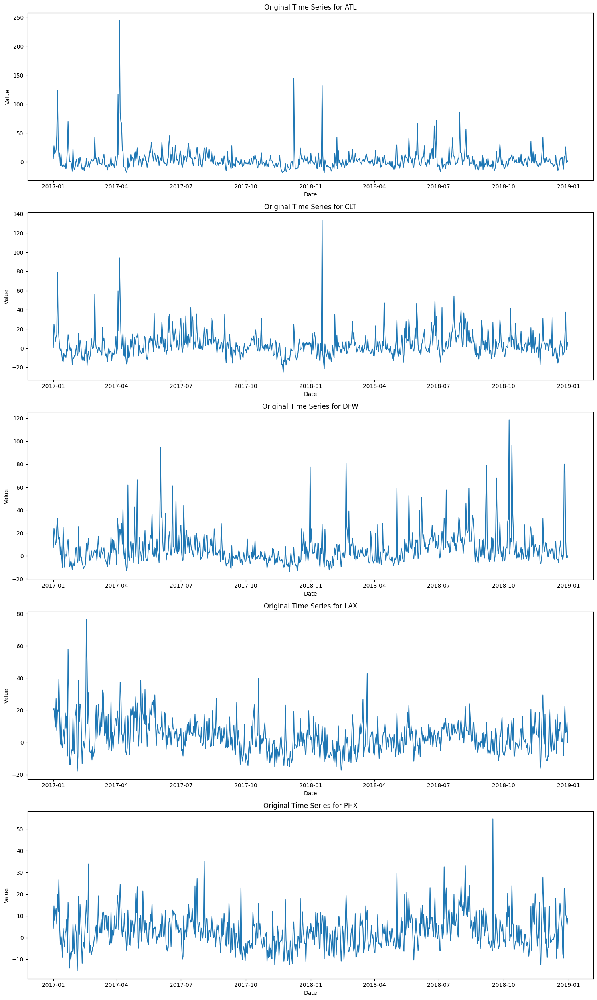

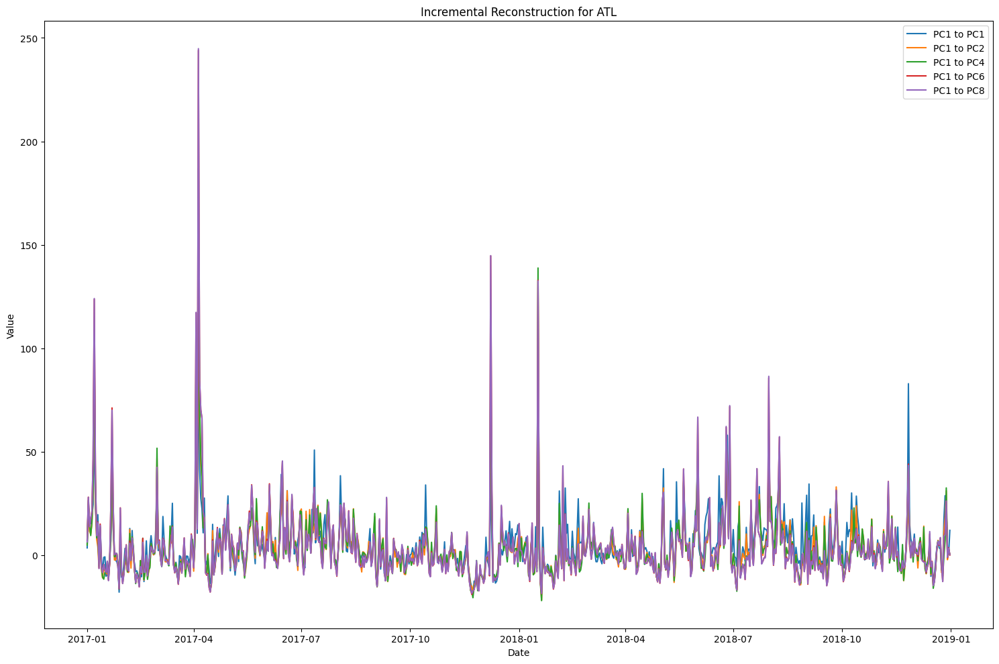

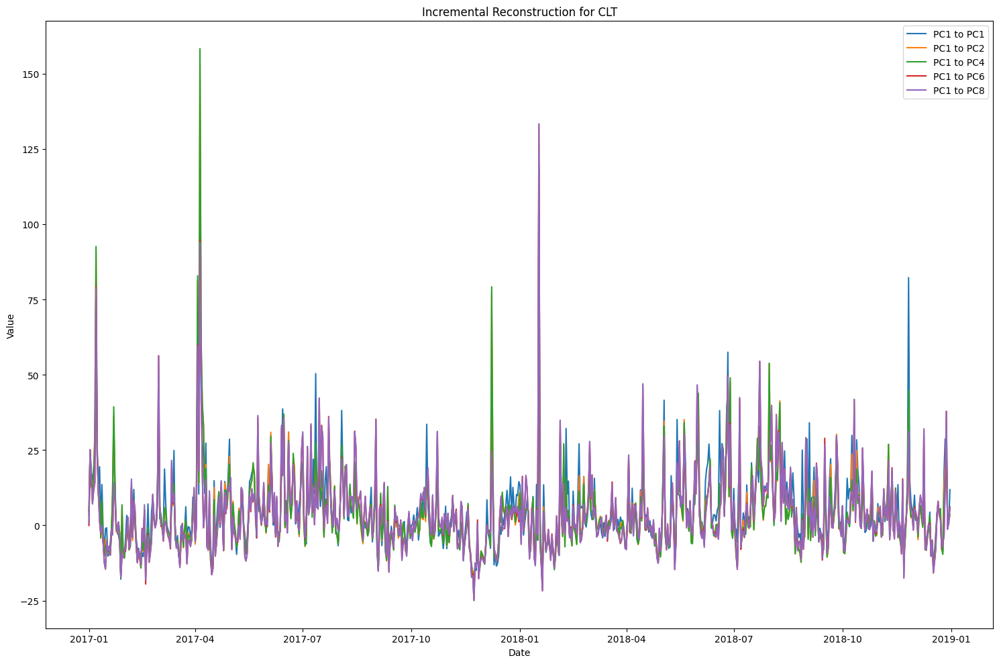

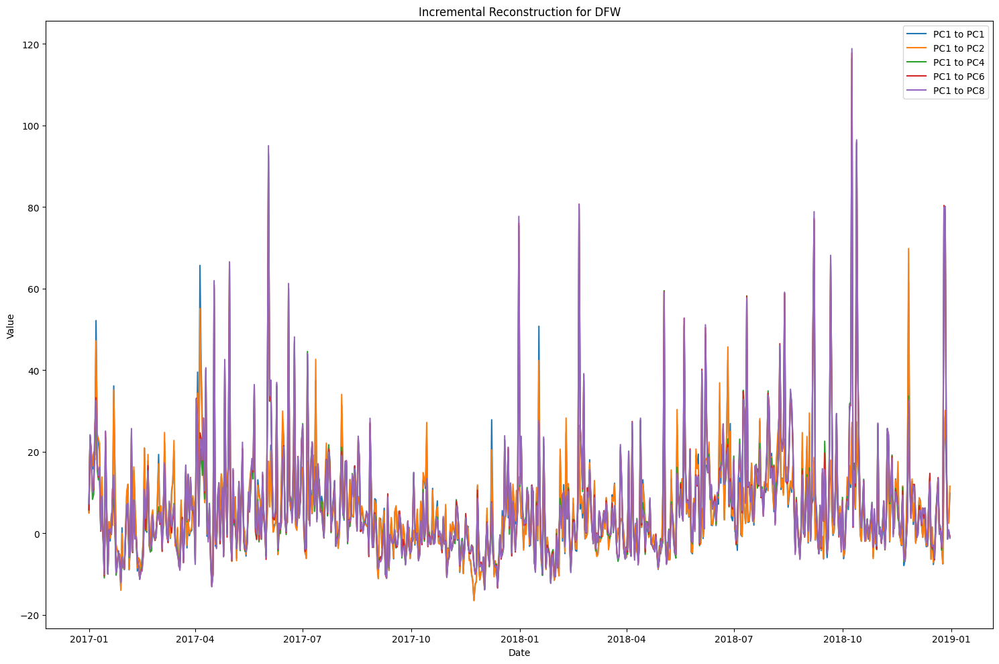

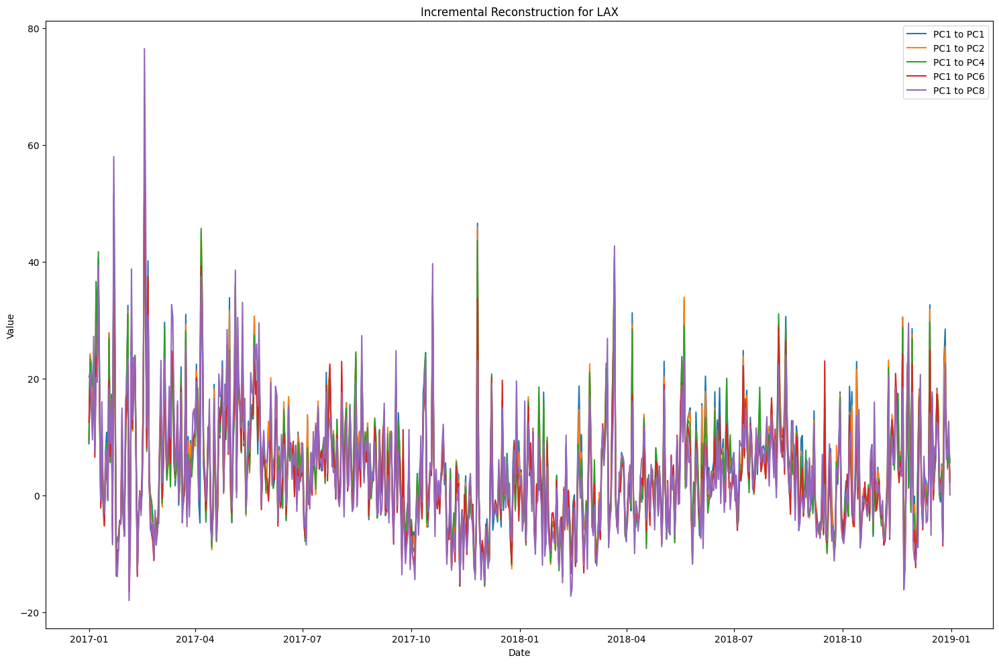

...

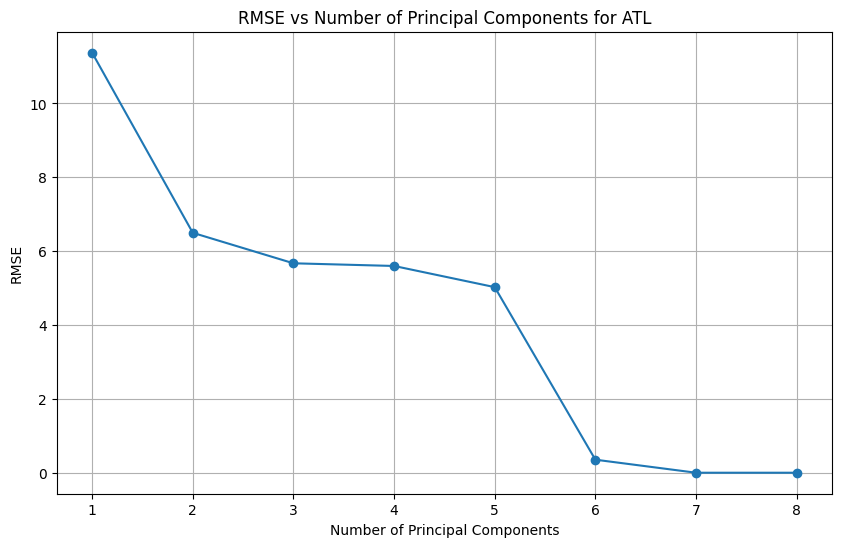

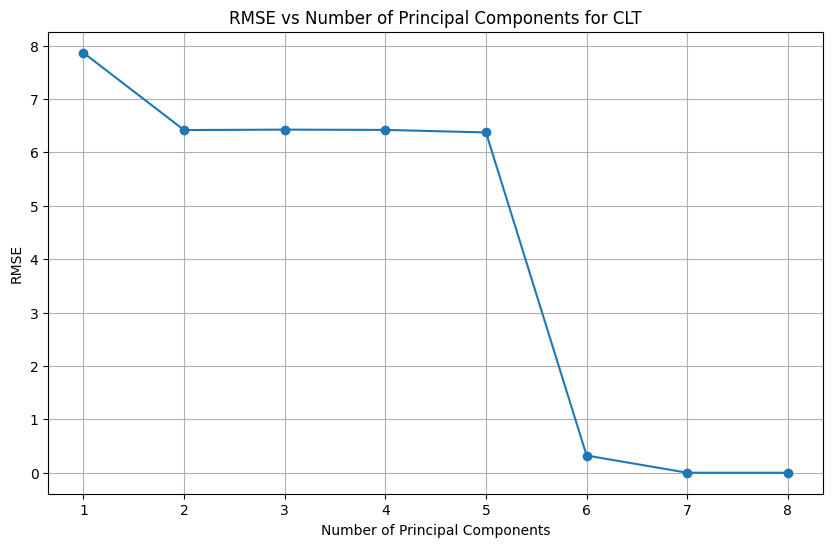

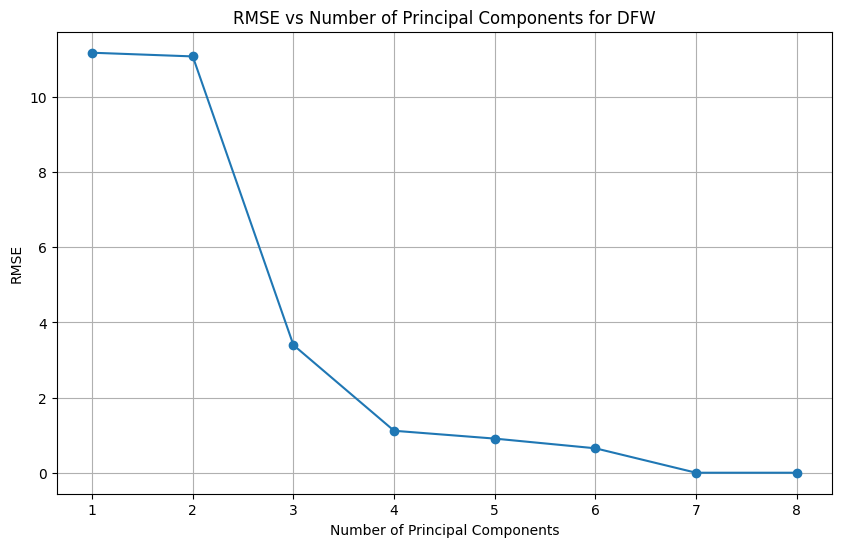

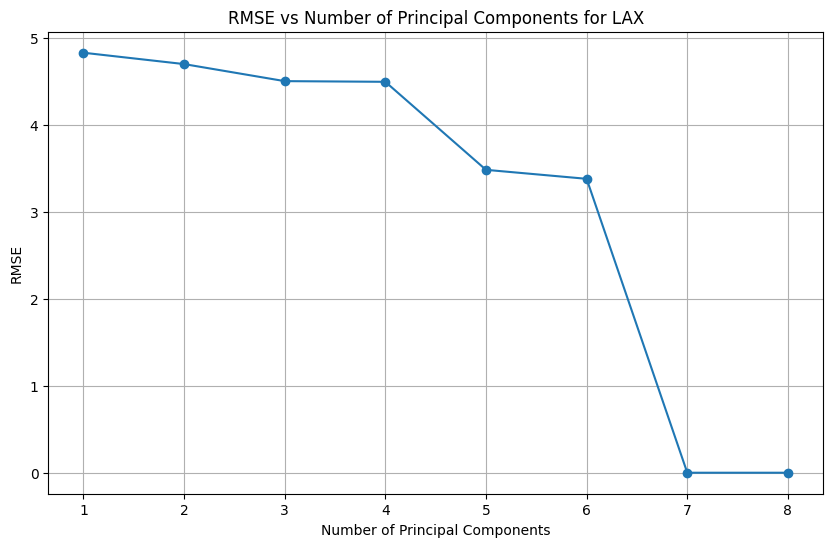

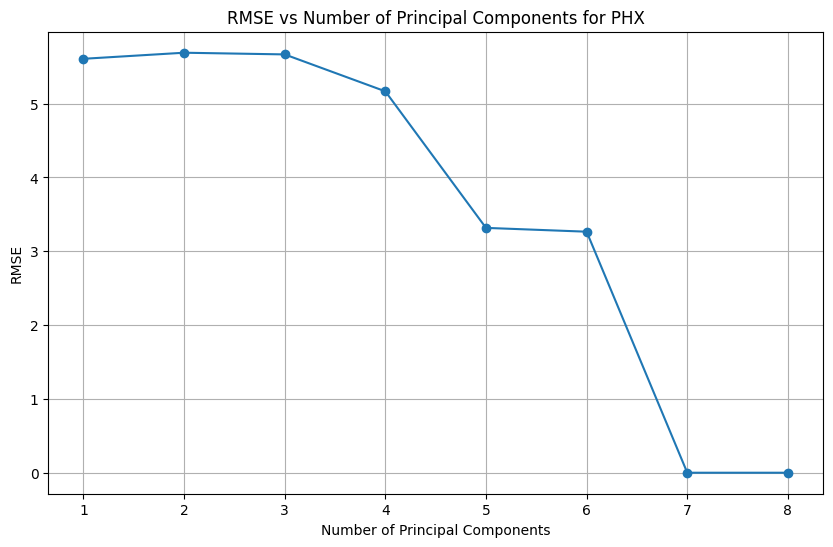

In [229]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error

original_df = data_raw_1
eigenValues, eigenVectors = get_sorted_eigen(df_cov)

def plot_state_figures(original_df, state_names):
    scaler = StandardScaler()
    STD_original_df = scaler.fit_transform(original_df)
    STD_original_df = pd.DataFrame(STD_original_df, index=original_df.index, columns=original_df.columns)

    cov_STD_original_df = np.cov(STD_original_df.T)
    eigenValues, eigenVectors = get_sorted_eigen(cov_STD_original_df)

    # Create date range
    dates = pd.date_range(start='2017-01-01', periods=730)

    # Figure 1: Original time-series
    plt.figure(figsize=(15, 5 * len(state_names)))
    for i, state in enumerate(state_names, 1):
        plt.subplot(len(state_names), 1, i)
        plt.plot(dates, original_df.loc[state])
        plt.title(f'Original Time Series for {state}')
        plt.ylabel('Value')
        plt.xlabel('Date')
    plt.tight_layout()
    plt.show()

    # Figure 2: Incremental reconstruction
    PCs_range = [1,2,4,6,8]

    for state in state_names:
        plt.figure(figsize=(15, 10))

        for PC_count in PCs_range:
            W = eigenVectors[:, :PC_count]
            projx = np.dot(STD_original_df, W)
            ReconX = projx.dot(W.T)
            reconstructed_df = pd.DataFrame(scaler.inverse_transform(ReconX), index=original_df.index,columns=original_df.columns)
            plt.plot(dates, reconstructed_df.loc[state], label=f'PC1 to PC{PC_count}')

        plt.title(f'Incremental Reconstruction for {state}')
        plt.ylabel('Value')
        plt.xlabel('Date')
        plt.legend()
        plt.tight_layout()
        plt.show()

    #Figure 3: The residual error of the best reconstruction with respect to the original time-series
    for state in state_names:
          plt.figure(figsize=(15, 10))

          df_reconstructed = []

          for PC_count in PCs_range:
              W = eigenVectors[:, :PC_count]
              projx = np.dot(STD_original_df, W)
              ReconX = projx.dot(W.T)
              reconstructed_df = pd.DataFrame(scaler.inverse_transform(ReconX), index=original_df.index,columns=original_df.columns)
              error = ((original_df.loc[state] - reconstructed_df.loc[state]) ** 2).mean()
              df_reconstructed = reconstructed_df.loc[state]

          residual_error = original_df.loc[state] - df_reconstructed

          plt.plot(dates, residual_error)
          plt.title(f'Residual Error for Best Reconstruction - {state}')
          plt.ylabel('Residual Error')
          plt.xlabel('Date')
          plt.tight_layout()
          plt.show()

# Figure 4: RMSE vs Number of Components
    max_components = 8
    rmse_values = {state: [] for state in state_names}

    for PC_count in range(1, max_components + 1):
        W = eigenVectors[:, :PC_count]
        projx = STD_original_df.dot(W)
        ReconX = projx.dot(W.T)
        reconstructed_df = pd.DataFrame(scaler.inverse_transform(ReconX),index=original_df.index, columns=original_df.columns)

        for state in state_names:
            original_df.loc[state] = original_df.loc[state]
            rmse = np.sqrt(mean_squared_error(original_df.loc[state], reconstructed_df.loc[state]))
            rmse_values[state].append(rmse)

    for state in state_names:
        plt.figure(figsize=(10, 6))
        plt.plot(range(1, max_components + 1), rmse_values[state], marker='o')
        plt.title(f'RMSE vs Number of Principal Components for {state}')
        plt.xlabel('Number of Principal Components')
        plt.ylabel('RMSE')
        plt.grid(True)
        plt.show()

# Call the function with multiple states
plot_state_figures(original_df, ['ATL', 'CLT', 'DFW', 'LAX', 'PHX'])

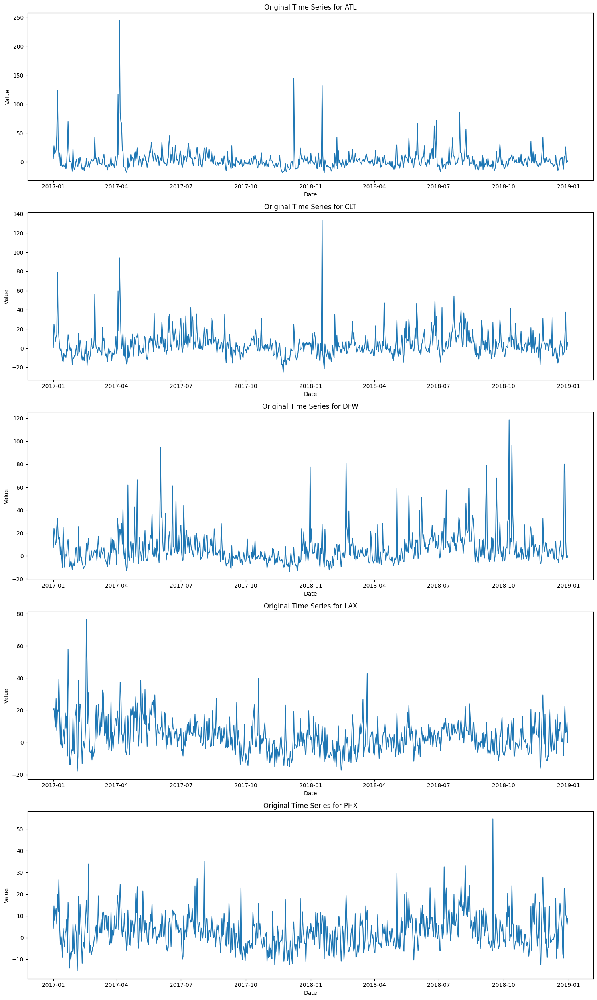

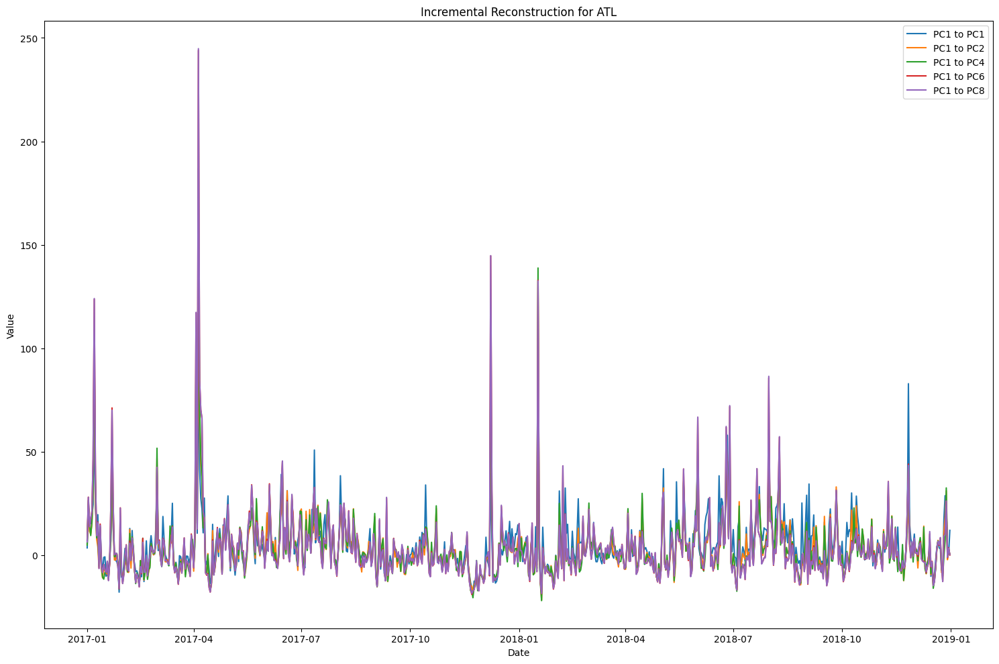

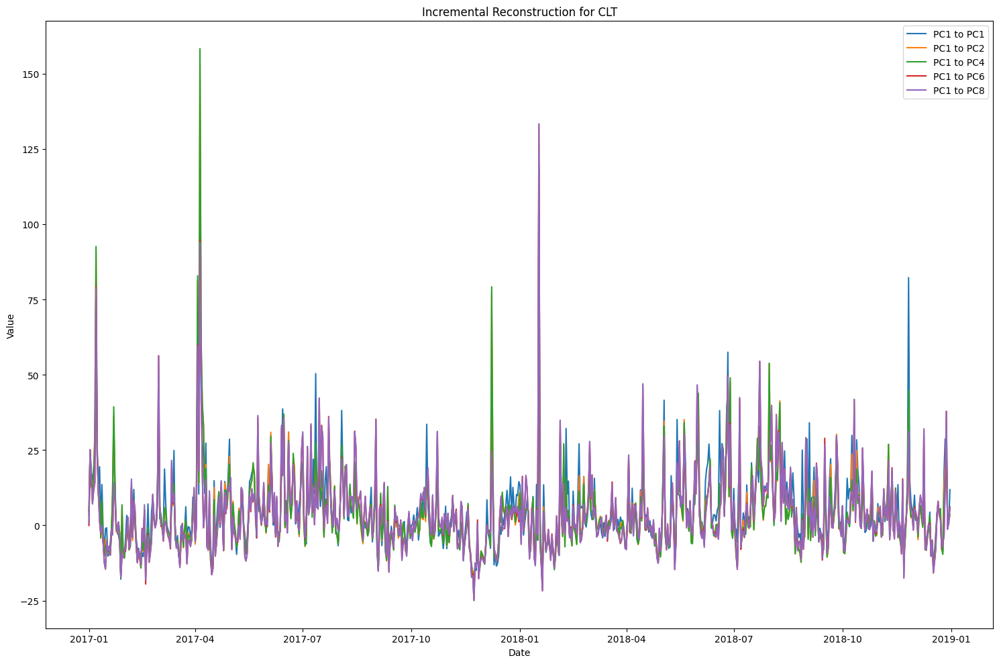

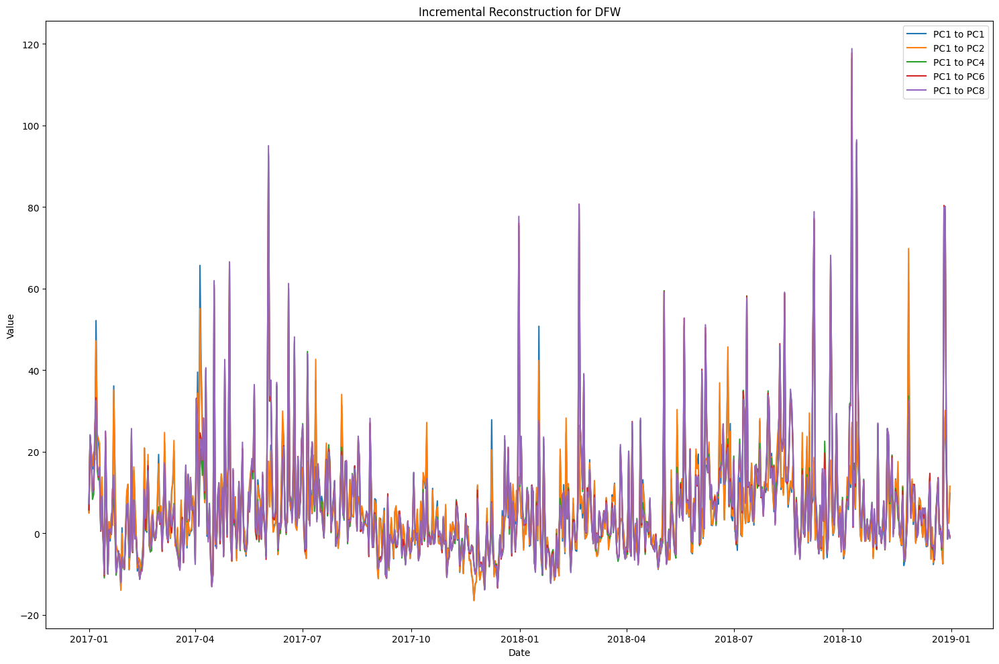

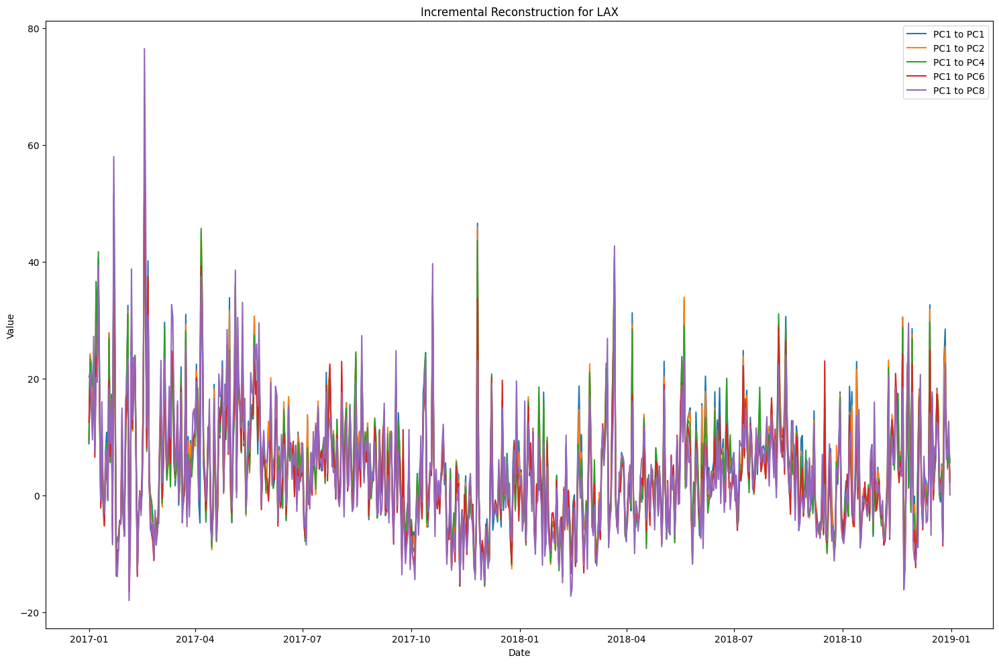

...

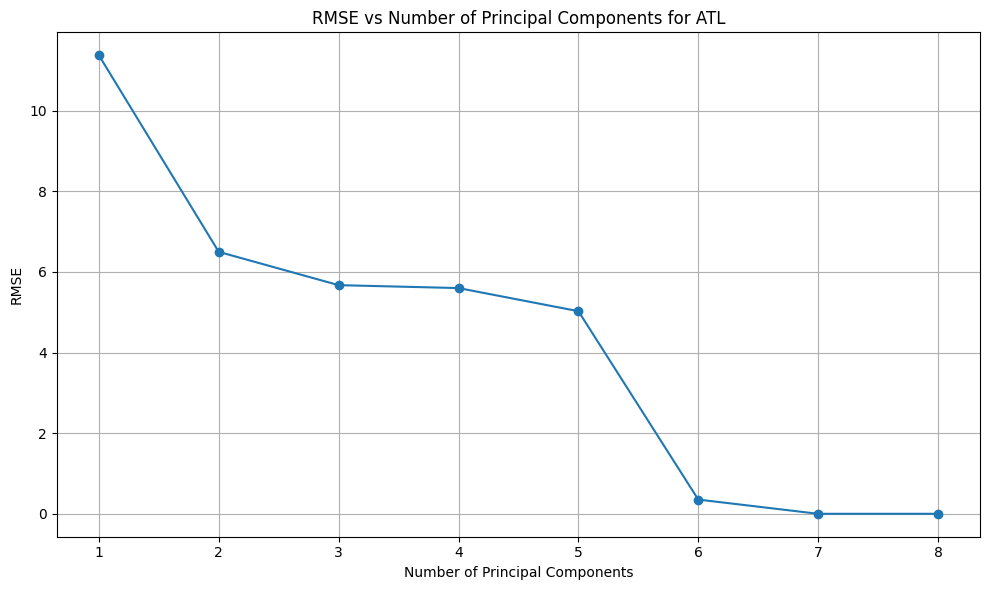

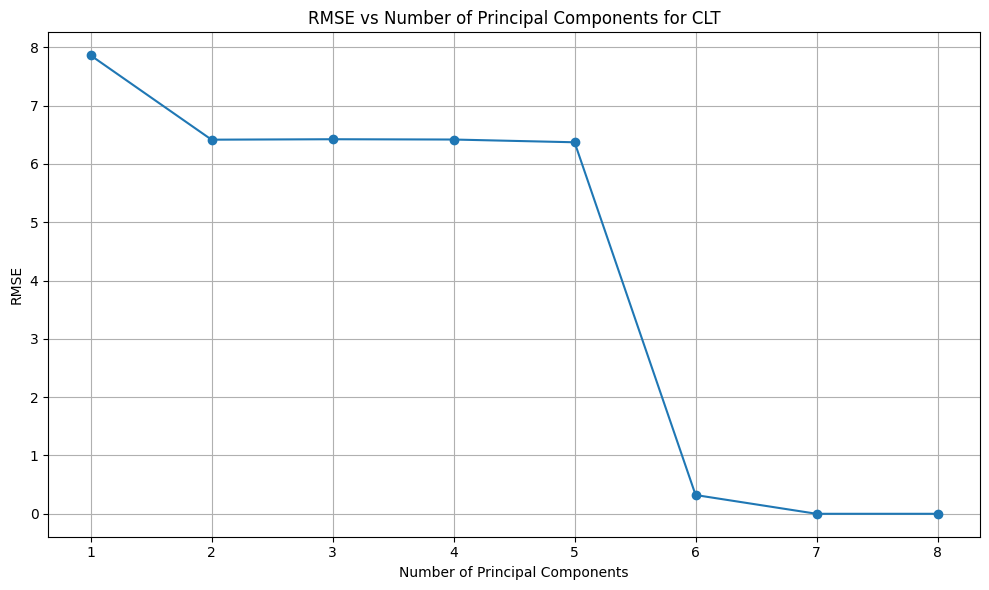

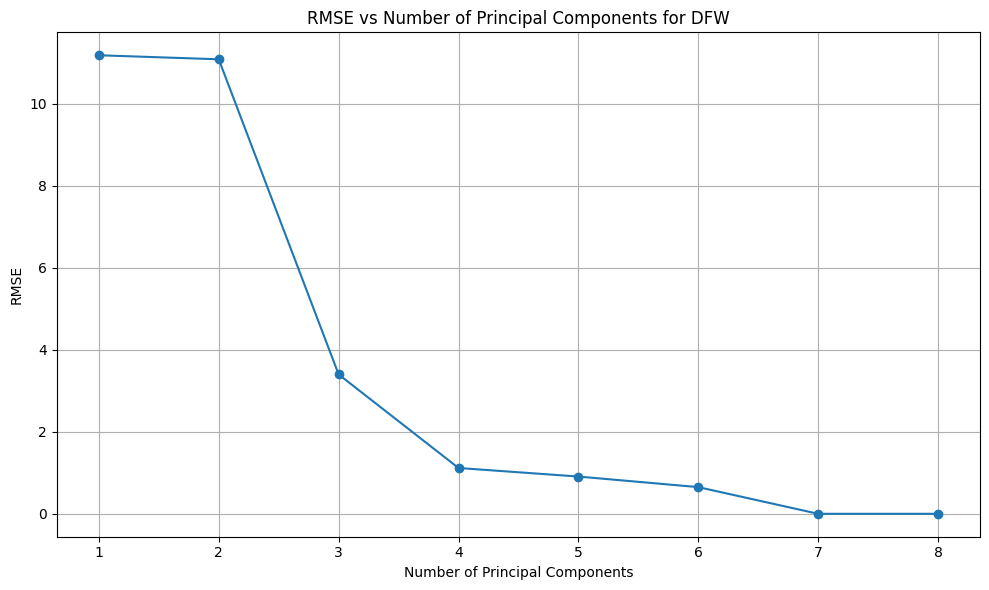

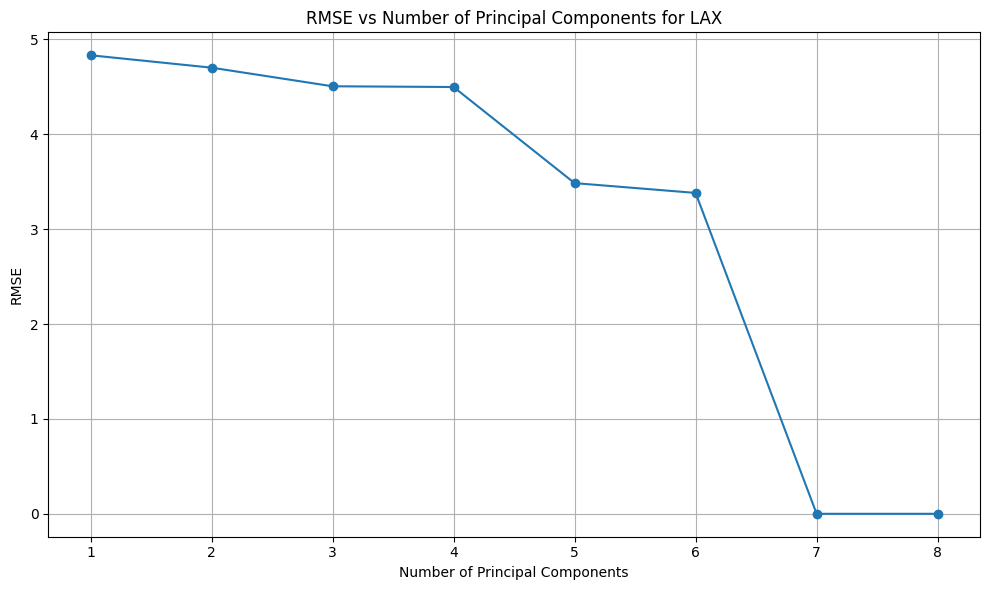

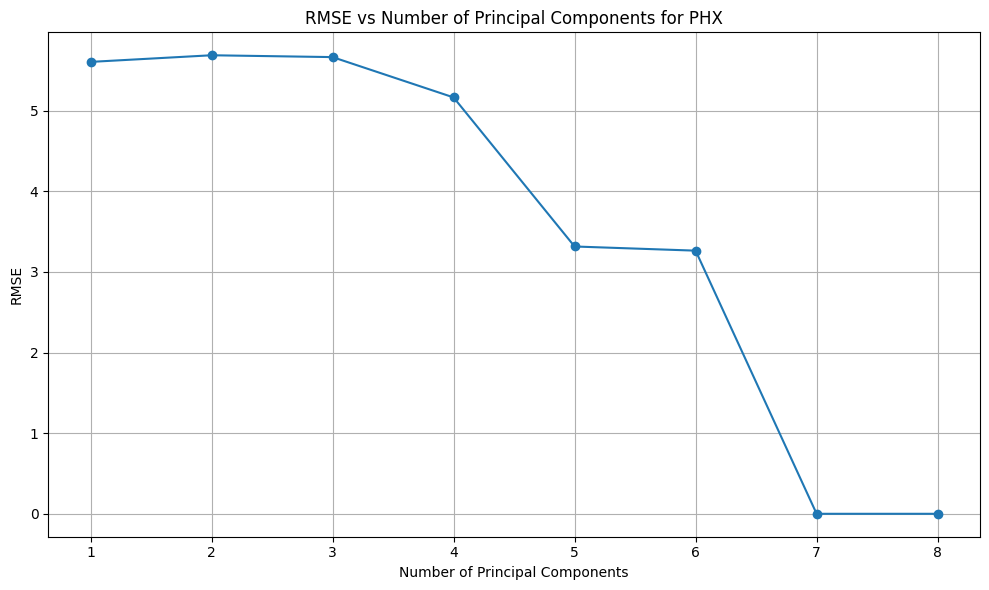

In [230]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error

original_df = data_raw_1
scaler = StandardScaler()
STD_original_df = scaler.fit_transform(original_df)
STD_original_df = pd.DataFrame(STD_original_df, index=original_df.index, columns=original_df.columns)

# Function to perform SVD and return components
def svd_C(STD_original_df):
    U, s, V = np.linalg.svd(STD_original_df, full_matrices=False)
    return U, s, V

def plot_state_figures_2(original_df, state_names):
    # Get SVD components
    U, s, V = svd_C(STD_original_df)

    # Create date range
    dates = pd.date_range(start='2017-01-01', periods=730)

    # Figure 1: Original time-series
    plt.figure(figsize=(15, 5 * len(state_names)))
    for i, state in enumerate(state_names, 1):
        plt.subplot(len(state_names), 1, i)
        plt.plot(dates, original_df.loc[state])
        plt.title(f'Original Time Series for {state}')
        plt.ylabel('Value')
        plt.xlabel('Date')
    plt.tight_layout()
    plt.show()

    # Figure 2: Incremental reconstruction
    PCs_range = [1, 2, 4, 6, 8]

    for state in state_names:
        plt.figure(figsize=(15, 10))

        for PC_count in PCs_range:
            W = V[:PC_count, :].T
            projx = np.dot(STD_original_df, W)
            ReconX = np.dot(projx, W.T)
            reconstructed_df = pd.DataFrame(scaler.inverse_transform(ReconX), index=original_df.index, columns=original_df.columns)
            plt.plot(dates, reconstructed_df.loc[state], label=f'PC1 to PC{PC_count}')



        plt.title(f'Incremental Reconstruction for {state}')
        plt.ylabel('Value')
        plt.xlabel('Date')
        plt.legend()
        plt.tight_layout()
        plt.show()

    # Figure 3: Residual Error of the best reconstruction
    for state in state_names:
        plt.figure(figsize=(15, 10))

        df_reconstructed =[]

        for PC_count in PCs_range:
            W = V[:PC_count, :].T
            projx = np.dot(STD_original_df, W)
            ReconX = np.dot(projx, W.T)
            reconstructed_df = pd.DataFrame(scaler.inverse_transform(ReconX), index=original_df.index,columns=original_df.columns)
            error = ((original_df.loc[state] - reconstructed_df.loc[state]) ** 2).mean()
            df_reconstructed = reconstructed_df.loc[state]

        residual_error = original_df.loc[state] - df_reconstructed

        plt.plot(dates, residual_error)
        plt.title(f'Residual Error for Best Reconstruction - {state}')
        plt.ylabel('Residual Error')
        plt.xlabel('Date')
        plt.tight_layout()
        plt.show()

    # Figure 4: RMSE vs Number of Components
    max_components = 8
    rmse_values = {state: [] for state in state_names}

    for PC_count in range(1, max_components + 1):
        W = V[:PC_count, :].T
        projx = np.dot(STD_original_df, W)
        ReconX = np.dot(projx, W.T)
        reconstructed_df = pd.DataFrame(scaler.inverse_transform(ReconX), index=original_df.index, columns=original_df.columns)

        for state in state_names:
            rmse = np.sqrt(mean_squared_error(original_df.loc[state], reconstructed_df.loc[state]))
            rmse_values[state].append(rmse)

    for state in state_names:
        plt.figure(figsize=(10, 6))
        plt.plot(range(1, max_components + 1), rmse_values[state], marker='o')
        plt.title(f'RMSE vs Number of Principal Components for {state}')
        plt.xlabel('Number of Principal Components')
        plt.ylabel('RMSE')
        plt.grid(True)
        plt.tight_layout()
        plt.show()

# Call the function with multiple states
plot_state_figures_2(original_df, ['ATL', 'CLT', 'DFW', 'LAX', 'PHX'])


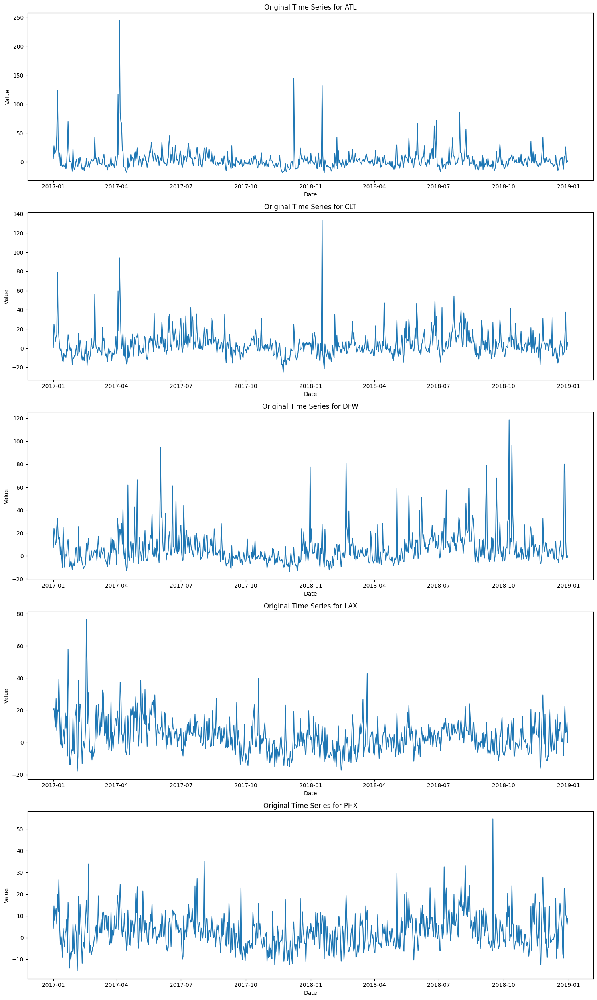

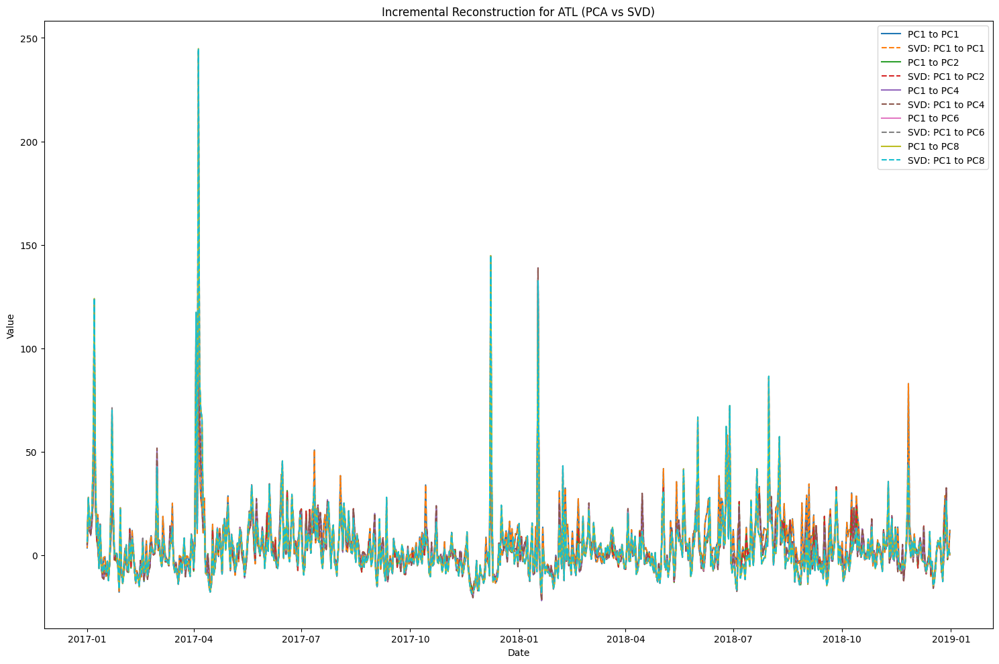

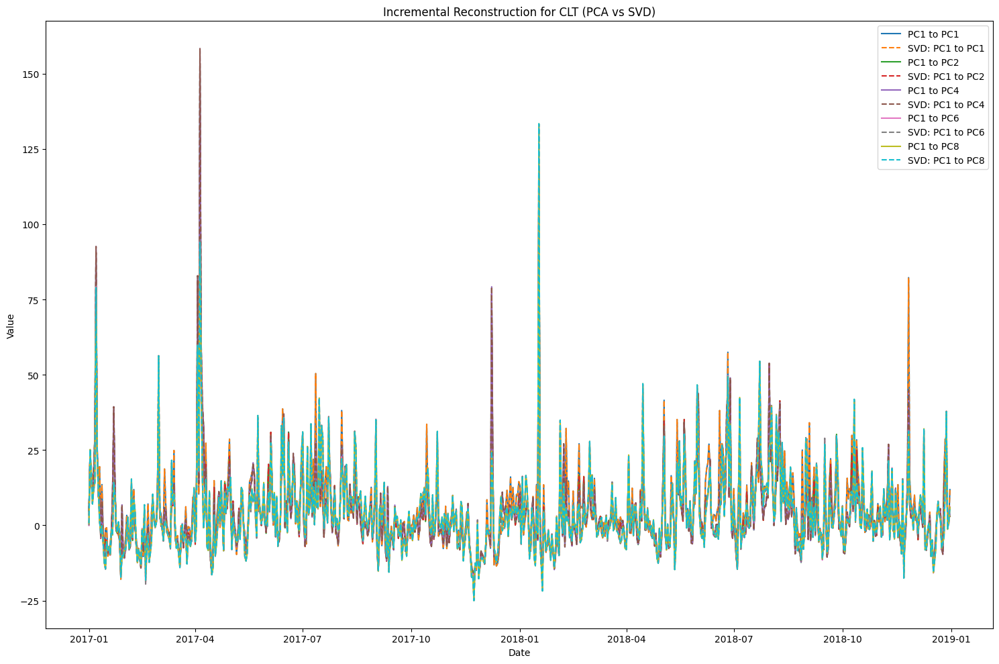

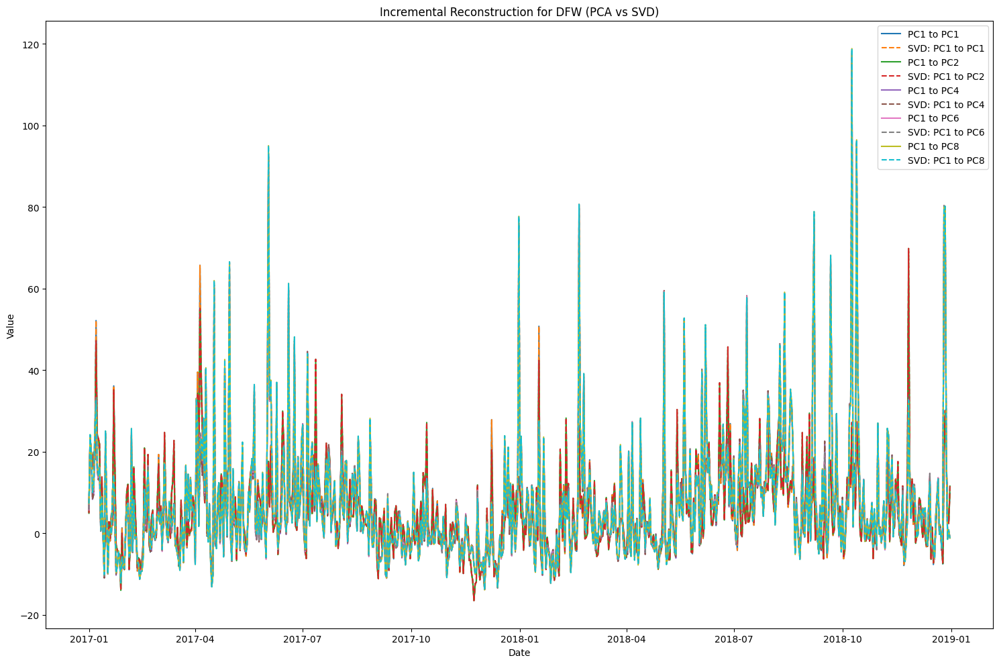

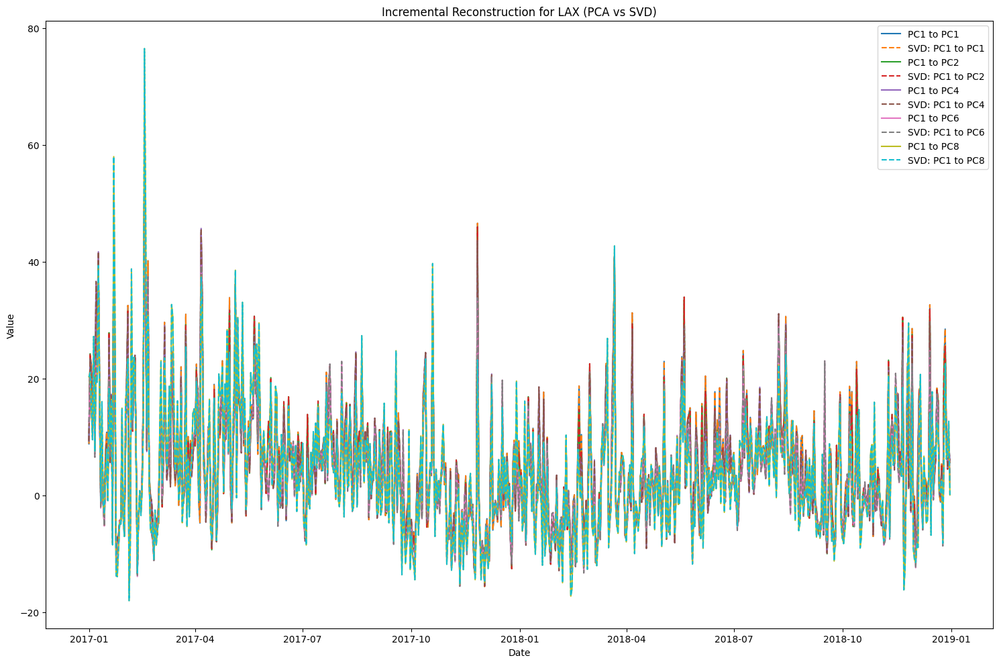

...

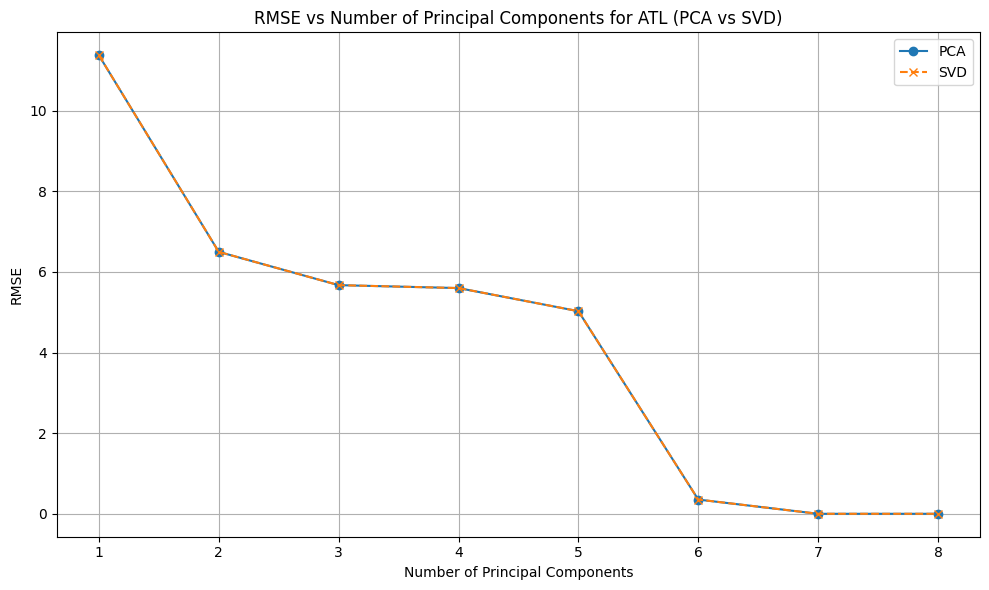

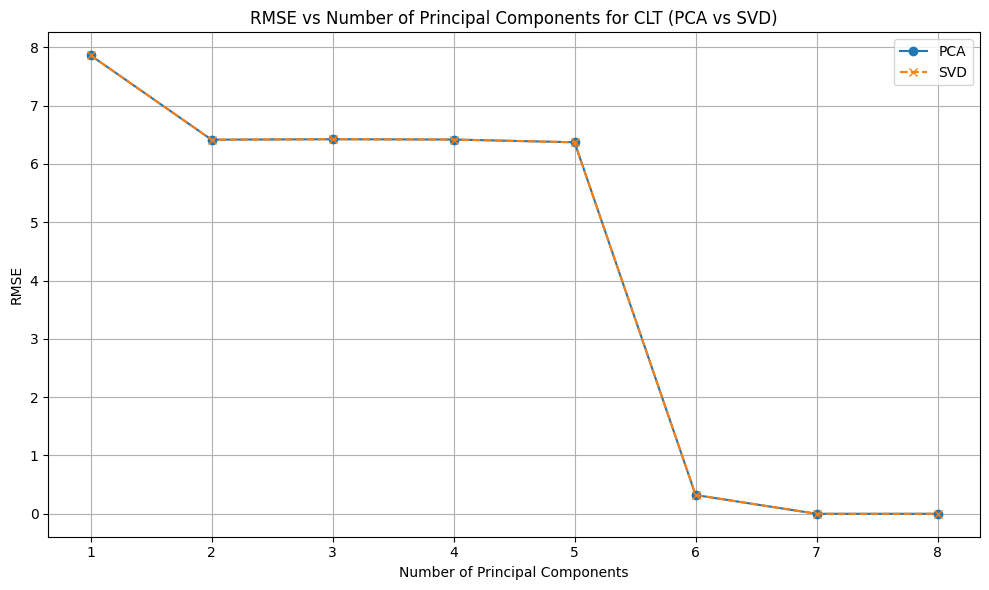

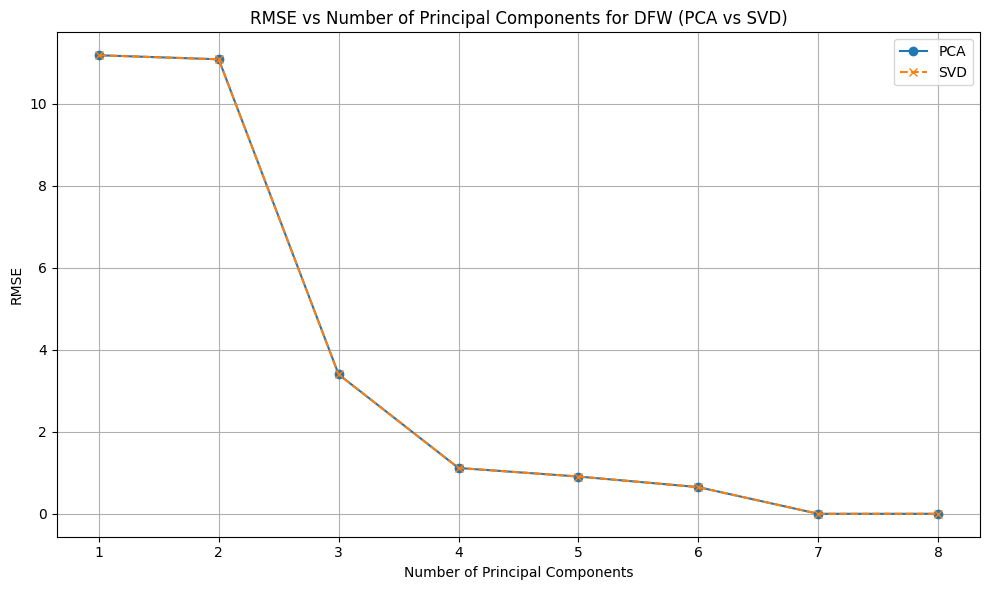

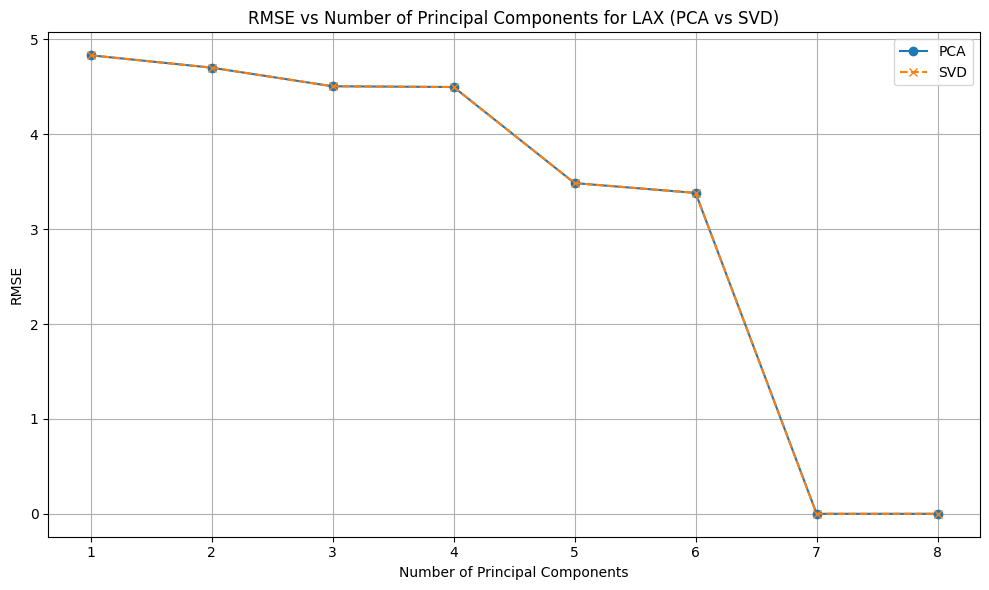

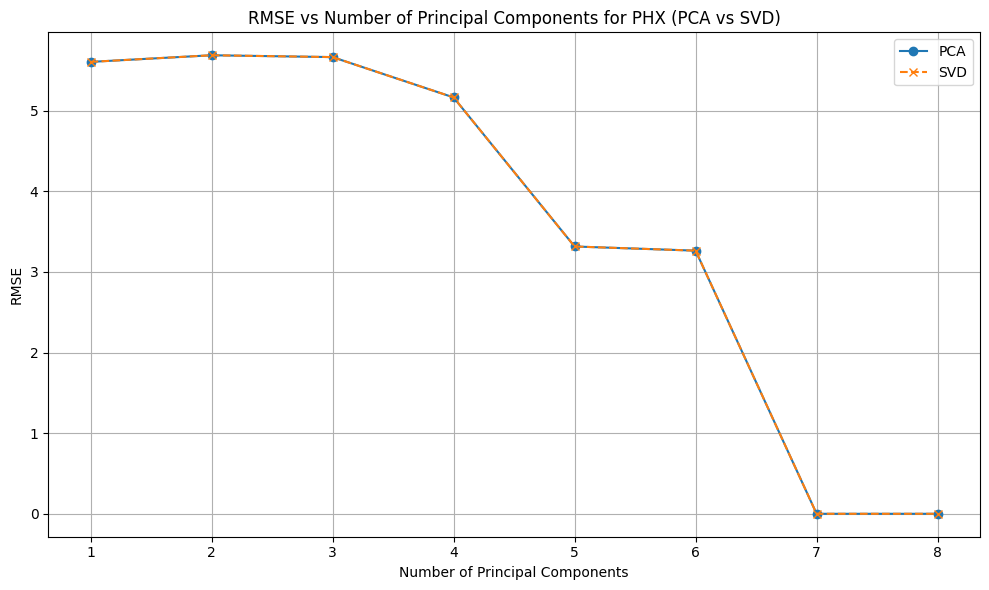

In [231]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error

eigenValues, eigenVectors = get_sorted_eigen(df_cov)

original_df = data_raw_1


def svd_C(STD_original_df):
    U, s, V = np.linalg.svd(STD_original_df, full_matrices=False)
    return U, s, V

def plot_state_figures(original_df, state_names):

    scaler = StandardScaler()
    STD_original_df = scaler.fit_transform(original_df)
    STD_original_df = pd.DataFrame(STD_original_df, index=original_df.index, columns=original_df.columns)

    cov_STD_original_df = np.cov(STD_original_df.T)
    eigenValues, eigenVectors = get_sorted_eigen(cov_STD_original_df)

    dates = pd.date_range(start='2017-01-01', periods=730)

    # Figure 1: Original time-series
    plt.figure(figsize=(15, 5 * len(state_names)))
    for i, state in enumerate(state_names, 1):
        plt.subplot(len(state_names), 1, i)
        plt.plot(dates, original_df.loc[state])
        plt.title(f'Original Time Series for {state}')
        plt.ylabel('Value')
        plt.xlabel('Date')
    plt.tight_layout()
    plt.show()

    # Figures 2: Incremental Reconstruction (PCA and SVD)
    PCs_range = [1, 2, 4, 6, 8]

    for state in state_names:
        plt.figure(figsize=(15, 10))

        for PC_count in PCs_range:
            W_pca = eigenVectors[:, :PC_count]
            projx = np.dot(STD_original_df, W_pca)
            ReconX = projx.dot(W_pca.T)
            reconstructed_df = pd.DataFrame(scaler.inverse_transform(ReconX), index=original_df.index,columns=original_df.columns)
            plt.plot(dates, reconstructed_df.loc[state], label=f'PC1 to PC{PC_count}')

            U, s, V = svd_C(STD_original_df)
            W = V[:PC_count, :].T
            projx_svd = np.dot(STD_original_df, W)
            ReconX_svd = np.dot(projx_svd, W.T)
            reconstructed_df_svd = pd.DataFrame(scaler.inverse_transform(ReconX_svd), index=original_df.index, columns=original_df.columns)
            plt.plot(dates, reconstructed_df_svd.loc[state], linestyle='--', label=f'SVD: PC1 to PC{PC_count}')

        plt.title(f'Incremental Reconstruction for {state} (PCA vs SVD)')
        plt.ylabel('Value')
        plt.xlabel('Date')
        plt.legend()
        plt.tight_layout()
        plt.show()

    # Figures 3: Residual Error (PCA and SVD)
    for state in state_names:
        plt.figure(figsize=(15, 10))


        for PC_count in PCs_range:

            W_pca = eigenVectors[:, :PC_count]
            projx_pca = np.dot(STD_original_df, W_pca)
            ReconX_pca = projx_pca.dot(W_pca.T)
            reconstructed_df_pca = pd.DataFrame(scaler.inverse_transform(ReconX_pca), index=original_df.index, columns=original_df.columns)




            U, s, V = svd_C(STD_original_df)
            W = V[:PC_count, :].T
            projx_svd = np.dot(STD_original_df, W)
            ReconX_svd = np.dot(projx_svd, W.T)
            reconstructed_df_svd = pd.DataFrame(scaler.inverse_transform(ReconX_svd), index=original_df.index, columns=original_df.columns)

        residual_error_pca = original_df.loc[state] - reconstructed_df_pca.loc[state]
        residual_error_svd = original_df.loc[state] - reconstructed_df_svd.loc[state]

        plt.plot(dates, residual_error_pca, label=f'PCA: PC1 to PC{PC_count}')
        plt.plot(dates, residual_error_svd, linestyle='--', label=f'SVD: PC1 to PC{PC_count}')
        plt.title(f'Residual Error for Best Reconstruction - {state} (PCA vs SVD)')
        plt.ylabel('Residual Error')
        plt.xlabel('Date')
        plt.legend()
        plt.tight_layout()
        plt.show()

    # Figures 4: RMSE vs Number of Components (PCA and SVD)
    max_components = 8
    rmse_values_pca = {state: [] for state in state_names}
    rmse_values_svd = {state: [] for state in state_names}

    for PC_count in range(1, max_components + 1):
        for state in state_names:

            W_pca = eigenVectors[:, :PC_count]
            projx_pca = STD_original_df.dot(W_pca)
            ReconX_pca = projx_pca.dot(W_pca.T)
            reconstructed_df_pca = pd.DataFrame(scaler.inverse_transform(ReconX_pca), index=original_df.index, columns=original_df.columns)
            rmse_pca = np.sqrt(mean_squared_error(original_df.loc[state], reconstructed_df_pca.loc[state]))
            rmse_values_pca[state].append(rmse_pca)


            U, s, V = svd_C(STD_original_df)
            W = V[:PC_count, :].T
            projx_svd = np.dot(STD_original_df, W)
            ReconX_svd = np.dot(projx_svd, W.T)
            reconstructed_df_svd = pd.DataFrame(scaler.inverse_transform(ReconX_svd), index=original_df.index, columns=original_df.columns)
            rmse_svd = np.sqrt(mean_squared_error(original_df.loc[state], reconstructed_df_svd.loc[state]))
            rmse_values_svd[state].append(rmse_svd)

    for state in state_names:
        plt.figure(figsize=(10, 6))
        plt.plot(range(1, max_components + 1), rmse_values_pca[state], marker='o', label='PCA')
        plt.plot(range(1, max_components + 1), rmse_values_svd[state], marker='x', linestyle='--', label='SVD')
        plt.title(f'RMSE vs Number of Principal Components for {state} (PCA vs SVD)')
        plt.xlabel('Number of Principal Components')
        plt.ylabel('RMSE')
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()

# Call the function with multiple states
plot_state_figures(original_df, ['ATL', 'CLT', 'DFW', 'LAX', 'PHX'])


How many features does the final dataset have? How many cities (ORIGIN airport codes) are there?
---
There are 730 features and 8 origin cities

Comment on the results [0.5]. When analyzing the cities (airport codes).
---
When analyzing the airports the same trend can be seen when using PCA and SVD. The results are the same with regards to RMSE values. Additionally, for the risidual error, the best was using the highest PCs number.

# References

Understanding PCA and SVD:

1. https://towardsdatascience.com/pca-and-svd-explained-with-numpy-5d13b0d2a4d8

2. https://stats.stackexchange.com/questions/134282/relationship-between-svd-and-pca-how-to-use-svd-to-perform-pca

3. https://stats.stackexchange.com/questions/2691/making-sense-of-principal-component-analysis-eigenvectors-eigenvalues

4. https://hadrienj.github.io/posts/Deep-Learning-Book-Series-2.8-Singular-Value-Decomposition/

PCA:

1. Snippets from: https://plot.ly/ipython-notebooks/principal-component-analysis/

2. https://www.value-at-risk.net/principal-component-analysis/

Flight Delays Data:

1. https://www.kaggle.com/datasets/gabrielluizone/us-domestic-flights-delay-prediction-2013-2018